**Dataset Summary**

The "Israel-HAMAS war news" dataset is an English-language dataset of news about Israel war against the terrorist organization - HAMAS that happened after "black Saturday" - massive murders of civilian Israeli people on the 7th of October 2023.

We've accumulated news from the following sources:

**BBC** (live news) - from 2023-11-05 to 2023-11-18. Total: 805

**The Times of Israel** (live news) - from 2023-10-07 to 2023-11-18. Total: 6581

**Al Jazeera** (live news) - from 2023-11-04 to 2023-11-25. Total: 3297

**Al Mayadeen** (articles from the site) - from 2023-10-08 to 2023-11-24. Total: 74

**WAFA "News" Agency** (articles from the site section "Occupation")- from 2023-09-28 to 2023-11-26. Total: 1020

**CNN live news** - from 2023-10-26 to 2023-11-26. Total: 1428

All news is collected using Beautiful Soup Python library. In the case of the BBC site, the WAFA site, and the Al Mayadeen site it was enough to use simple GET requests and in the other cases we used Silenium.

https://huggingface.co/datasets/aav-ds/Israel-HAMAS_war_news

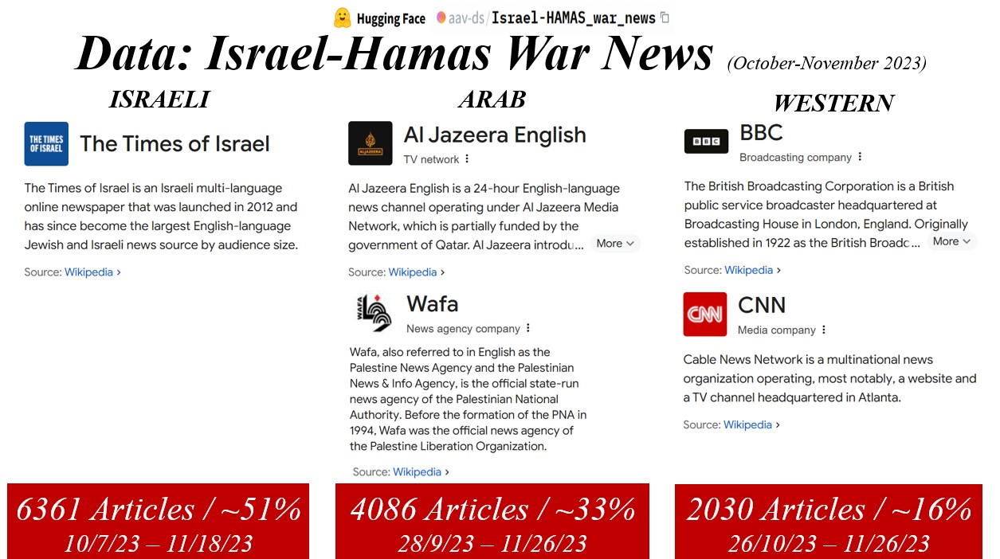

# **Data Pre-processing**

In [1]:
pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 484.9/484.9 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 11.6 MB/s eta 0:00:00


In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from collections import Counter
from textblob import TextBlob
from wordcloud import WordCloud
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF

In [3]:
from datasets import load_dataset
ds = load_dataset("aav-ds/Israel-HAMAS_war_news")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/6.62k [00:00<?, ?B/s]

train-00000-of-00001.parquet:   0%|          | 0.00/6.08M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/13103 [00:00<?, ? examples/s]

In [4]:
df = ds['train'].to_pandas()
df.head()

,url,datetime,title,text,provider,source
0,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T18:05:00,A look at where things stand,Confusion over al-Shifa evacuation: The direct...,BBC,site-live-news
1,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T17:36:00,'It's a nightmare for us',"Thousands of protesters shouted ""now, bring th...",BBC,site-live-news
2,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T17:18:00,Israeli army says it's expanding operations in...,A little earlier we reported on claims that a ...,BBC,site-live-news
3,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T16:57:00,Six weeks of war between Hamas in Gaza and Israel,"As evening sets in across Gaza, here's a small...",BBC,site-live-news
4,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T16:31:00,New UK foreign secretary speaks to Israeli cou...,"In the UK, the new Foreign Secretary David Cam...",BBC,site-live-news


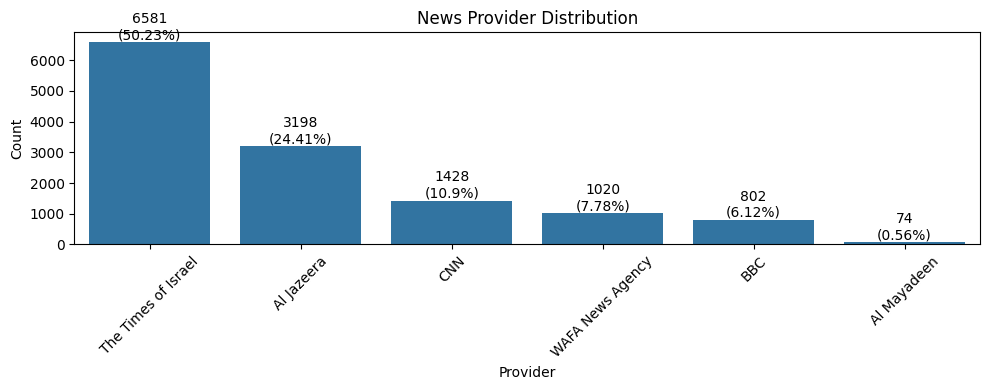

In [5]:
# Calculate provider distribution
provider_stats = df['provider'].value_counts().reset_index()
provider_stats.columns = ['Provider', 'Count']
provider_stats['Percentage'] = (provider_stats['Count'] / len(df) * 100).round(2)

# Plotting
plt.figure(figsize=(10, 4))
sns.barplot(data=provider_stats, x='Provider', y='Count')
plt.xticks(rotation=45)

# Add count and percentage labels on bars
for i, v in enumerate(provider_stats['Count']):
    plt.text(i, v, f'{v}\n({provider_stats["Percentage"][i]}%)',
             ha='center', va='bottom')

plt.title('News Provider Distribution')
plt.tight_layout()
plt.show()

We have ~50% pro-Israeli news (assuming Times of Israel are pro-Israel), ~33% pro-Hamas news (Assuming Al Jazeera, WAFA and Al Mayadeen are pro-Hamas) and ~17% Western news (BBC and CNN).

Text(0.5, 1.0, 'Article Length Distribution')

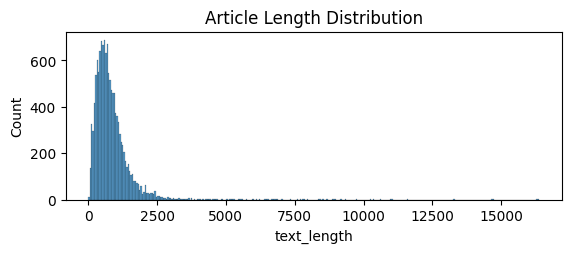

In [6]:
df['text_length'] = df['text'].str.len()
plt.subplot(2, 1, 1)
sns.histplot(df['text_length'])
plt.title('Article Length Distribution')

Most Articles have less than 1500 words

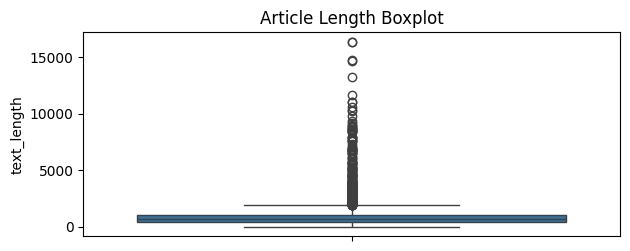

In [7]:
plt.subplot(2, 1, 2)
sns.boxplot(y=df['text_length'])
plt.title('Article Length Boxplot')
plt.tight_layout()

In [8]:
# Calculate IQR and bounds
Q1 = df['text_length'].quantile(0.25)
Q3 = df['text_length'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Count outliers
outliers = df[df['text_length'] > upper_bound]
print(f"Number of outliers: {len(outliers)}")
print(f"Percentage of outliers: {(len(outliers)/len(df))*100:.2f}%")

Number of outliers: 557
Percentage of outliers: 4.25%


In [9]:
# Count outliers by provider
outliers_by_provider = df[df['text_length'] > upper_bound].groupby('provider').size()
outliers_percentage = (outliers_by_provider / df.groupby('provider').size() * 100).round(2)

results = pd.DataFrame({
   'Outlier_Count': outliers_by_provider,
   'Percentage': outliers_percentage
}).sort_values('Outlier_Count', ascending=False)

print(results)

                     Outlier_Count  Percentage
provider                                      
The Times of Israel            220        3.34
CNN                            190       13.31
Al Mayadeen                     74      100.00
WAFA News Agency                59        5.78
BBC                              8        1.00
Al Jazeera                       6        0.19


In order to avoid long paddings I will drop all outliers

In [10]:
# Remove outliers
df = df[df['text_length'] <= upper_bound]

Checking for NaNs

In [11]:
# Check remaining nulls
print("Total nulls:", df.isnull().sum().sum())
print("\nNulls by column:")
print(df.isnull().sum()[df.isnull().sum() > 0])

Total nulls: 68

Nulls by column:
title    68
dtype: int64


In [12]:
df['title'].isna().groupby(df['provider']).sum().reset_index()

,provider,title
0,Al Jazeera,66
1,BBC,2
2,CNN,0
3,The Times of Israel,0
4,WAFA News Agency,0


Lets just remove it is at is neglected

In [13]:
df = df[~((df['provider'].isin(['Al Jazeera', 'BBC'])) & (df['title'].isna()))]
df.isna().sum()

,0
url,0
datetime,0
title,0
text,0
provider,0
source,0
text_length,0


In [14]:
# Create source categories
df['source_category'] = df['provider'].map({
   'Al Jazeera': 'Arab',
   'WAFA News Agency': 'Arab',
   'CNN': 'Western',
   'BBC': 'Western',
   'The Times of Israel': 'Israeli'
})

<ipython-input-14-e74dba732dd7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['source_category'] = df['provider'].map({


I mapped sources to 3 categories: Israeli, Arab and Western. The model will learn their chrachteristics and predict which category is a new article about. The new class balance is:

In [15]:
print(df['source_category'].value_counts())
print('\nPercentage distribution:')
print(df['source_category'].value_counts(normalize=True).mul(100).round(2), '%')

source_category
Israeli    6361
Arab       4087
Western    2030
Name: count, dtype: int64

Percentage distribution:
source_category
Israeli    50.98
Arab       32.75
Western    16.27
Name: proportion, dtype: float64 %


And the new length of article distribution:

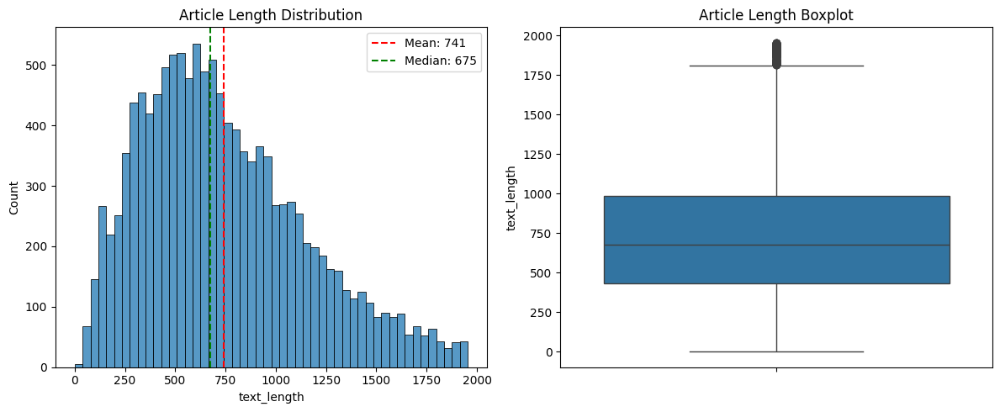

In [16]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.histplot(data=df, x='text_length', bins=50)
plt.axvline(df['text_length'].mean(), color='red', linestyle='--', label=f'Mean: {df["text_length"].mean():.0f}')
plt.axvline(df['text_length'].median(), color='green', linestyle='--', label=f'Median: {df["text_length"].median():.0f}')
plt.title('Article Length Distribution')
plt.legend()

plt.subplot(1, 2, 2)
sns.boxplot(data=df, y='text_length')
plt.title('Article Length Boxplot')

plt.tight_layout()

In [17]:
df.head()

,url,datetime,title,text,provider,source,text_length,source_category
0,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T18:05:00,A look at where things stand,Confusion over al-Shifa evacuation: The direct...,BBC,site-live-news,1526,Western
1,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T17:36:00,'It's a nightmare for us',"Thousands of protesters shouted ""now, bring th...",BBC,site-live-news,874,Western
2,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T17:18:00,Israeli army says it's expanding operations in...,A little earlier we reported on claims that a ...,BBC,site-live-news,888,Western
3,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T16:57:00,Six weeks of war between Hamas in Gaza and Israel,"As evening sets in across Gaza, here's a small...",BBC,site-live-news,178,Western
4,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T16:31:00,New UK foreign secretary speaks to Israeli cou...,"In the UK, the new Foreign Secretary David Cam...",BBC,site-live-news,629,Western


Let's see an example article

In [18]:
df.loc[0, 'text']

"Confusion over al-Shifa evacuation: The director of Gaza City's largest hospital, al-Shifa, said earlier that the Israeli military had ordered an evacuation there. Israel denied this, saying it had agreed to an evacuation request from the director himself.\nPeople leave hospital complex: Hundreds left al-Shifa throughout Saturday, following days of the Israel Defense Forces (IDF) searching the facility for an apparent command centre that it says lies underneath. (It has shown pictures of an alleged tunnel shaft and weapons as evidence so far.)\nBlast reported at UN school-turned-shelter: The IDF said earlier that it was investigating unconfirmed reports of deaths at a UN-run school-turned-shelter in Jabalia, northern Gaza. Footage, which BBC Verify has analysed, shows many people - including women and children - with severe injuries or lying motionless on the floor.\nWounded children reach UAE: The first flight carrying around 15 injured Palestinian children and their families landed 

In [19]:
def find_non_ascii(text):
    return ''.join(char for char in text if ord(char) >= 128)

# Check sample of non-ASCII
non_ascii_samples = df['text'].apply(find_non_ascii)
non_ascii_samples = non_ascii_samples[non_ascii_samples != '']
print(non_ascii_samples.head())

1    ’’“’’”
4         ’
5       “”“
6       –––
7       ’””
Name: text, dtype: object


In [20]:
# Look for HTML tags
html_pattern = r'<[^>]+>'
df['text'].str.contains(html_pattern).sum()

0

In [21]:
def find_control_chars(text):
    return ''.join(char for char in text if ord(char) < 32)

control_chars = df['text'].apply(find_control_chars)
control_chars = control_chars[control_chars != '']
print(control_chars.head())

0                      \n\n\n\n
1          \n\n\n\n\n\n\n\n\n\n
2                      \n\n\n\n
4          \n\n\n\n\n\n\n\n\n\n
5    \n\n\n\n\n\n\n\n\n\n\n\n\n
Name: text, dtype: object


Min length: 1
Max length: 1954


<Axes: >

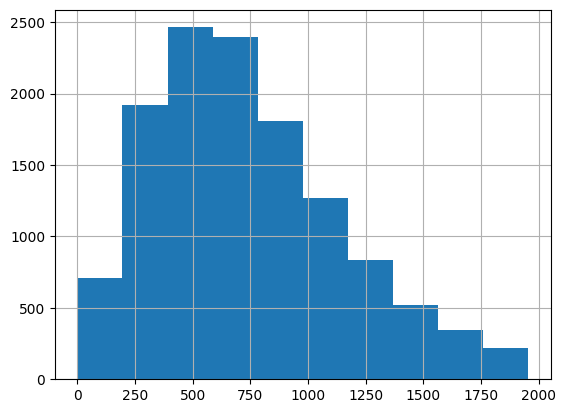

In [22]:
# Look for suspiciously short or empty texts
print("Min length:", df['text'].str.len().min())
print("Max length:", df['text'].str.len().max())

# Distribution of lengths
df['text'].str.len().hist()

In [23]:
# Look at very short articles
very_short = df[df['text'].str.len() < 20]
print("Number of very short articles:", len(very_short))
print("\nExample short articles:")
print(very_short['text'].head())

Number of very short articles: 1

Example short articles:
8825    –
Name: text, dtype: object


In [24]:
# Remove the single very short article
df = df[df['text'].str.len() > 1]

In [25]:
# Check for common problematic strings
problems = ['[removed]', '[deleted]', ']]>', '<?xml', '&amp;', '&quot;']
for prob in problems:
    count = df['text'].str.contains(prob).sum()
    if count > 0:
        print(f"Found {count} instances of {prob}")

Found 12477 instances of [removed]
Found 12477 instances of [deleted]


In [26]:
# Check actual count
print("Articles with [removed]:", df['text'].str.contains('\[removed\]').sum())
print("Articles with [deleted]:", df['text'].str.contains('\[deleted\]').sum())

Articles with [removed]: 0
Articles with [deleted]: 0


In [27]:
# First check your data
print("Total samples:", len(df))
print("\nClass distribution:")
print(df['source_category'].value_counts())


Total samples: 12477

Class distribution:
source_category
Israeli    6361
Arab       4086
Western    2030
Name: count, dtype: int64


In [28]:
# Convert labels to numeric
label_map = {'Israeli': 0, 'Arab': 1, 'Western': 2}
labels = df['source_category'].map(label_map)
# Verify conversion
print("\nNumeric label distribution:")
print(labels.value_counts())


Numeric label distribution:
source_category
0    6361
1    4086
2    2030
Name: count, dtype: int64


# **Task 1: Source Classification & Word Importance**

 - **Classify articles as Israeli / Arab / Western with high accuracy**
 - **Perform SHAP analysis on word importance in each category**

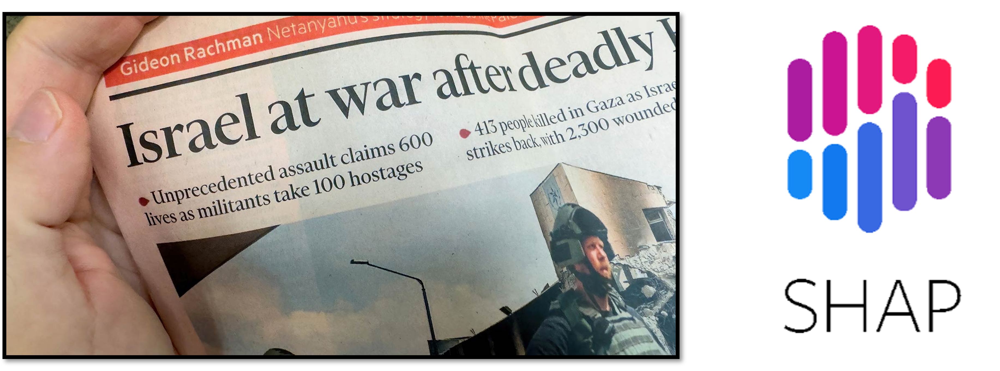

**Tokenization**

Next, we start the tokenization. I choose to leave article and text seperated so I will be able to see how the model treats them differently. I also choose embedding that tokenizes words and not full text (like S-BERT) because I will want to point at important words for classification.

Checking if BERT base with 512 token length can handle my articles and titles seperately, so I can see their influence on classification

In [ ]:
# Check title token lengths
from transformers import BertTokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
title_lengths = df['title'].apply(lambda x: len(tokenizer.encode(x)))
print("Max title length:", title_lengths.max())
print("Average title length:", title_lengths.mean())

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

Max title length: 34
Average title length: 15.38703213913601


In [ ]:
from transformers import BertTokenizer

# Initialize tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Calculate token lengths for texts
text_token_lengths = df['text'].apply(lambda x: len(tokenizer.encode(x)))

# Check how many texts exceed 469 tokens
truncated_texts = (text_token_lengths > 469).sum()

print(f"Total number of texts: {len(text_token_lengths)}")
print(f"Number of texts that will be truncated: {truncated_texts}")
print(f"Percentage of texts truncated: {truncated_texts / len(text_token_lengths) * 100:.2f}%")

Token indices sequence length is longer than the specified maximum sequence length for this model (525 > 512). Running this sequence through the model will result in indexing errors


Total number of texts: 12477
Number of texts that will be truncated: 22
Percentage of texts truncated: 0.18%


Token indices sequence length is longer than the specified maximum sequence length for this model (525 > 512). Running this sequence through the model will result in indexing errors


Distribution of articles exceeding 469 tokens:
count     22.000000
mean     535.636364
std       55.166023
min      473.000000
25%      499.000000
50%      525.000000
75%      570.000000
max      720.000000
Name: text, dtype: float64

Exact token lengths of these articles:
text
473    1
483    2
486    2
499    2
507    1
516    2
525    2
530    2
539    1
570    2
574    1
583    1
585    2
720    1
Name: count, dtype: int64


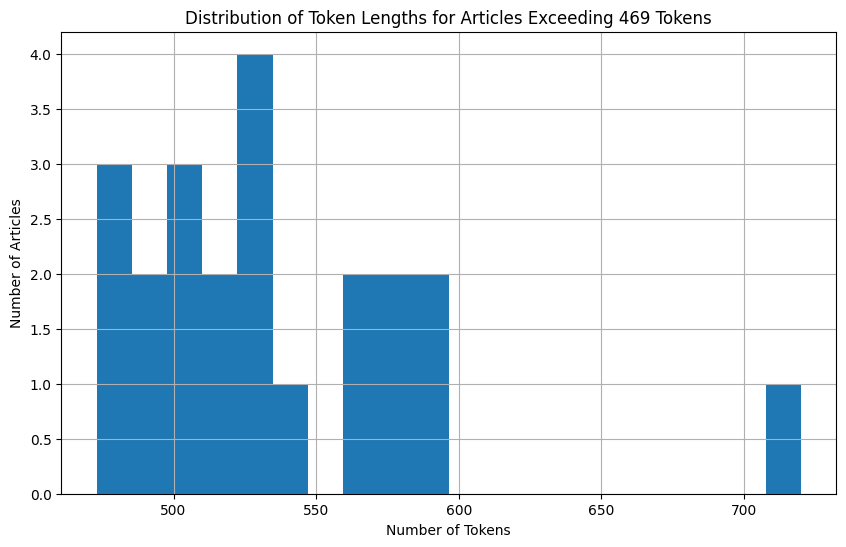

In [ ]:
from transformers import BertTokenizer
import matplotlib.pyplot as plt

# Initialize tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Calculate token lengths for texts
text_token_lengths = df['text'].apply(lambda x: len(tokenizer.encode(x)))

# Find articles exceeding 469 tokens
exceeding_articles = text_token_lengths[text_token_lengths > 469]

print("Distribution of articles exceeding 469 tokens:")
print(exceeding_articles.describe())

print("\nExact token lengths of these articles:")
print(exceeding_articles.value_counts().sort_index())

# Visualize the distribution
plt.figure(figsize=(10, 6))
exceeding_articles.hist(bins=20)
plt.title('Distribution of Token Lengths for Articles Exceeding 469 Tokens')
plt.xlabel('Number of Tokens')
plt.ylabel('Number of Articles')
plt.show()

Decided not to delete 22 articles but to allow their trancation at 469, since classifiers can handle trancation and that most of the info is maintained which could help. Anyway it is a redundent portion so deleting would not change much either.

Total BERT token limit: 512 tokens

Special tokens [CLS] and [SEP]: 3 tokens

Remaining for titles and text: 509 tokens

Proposed allocation:

Titles: max 40 tokens

Texts: 469 tokens

Next I will create a Dataset Class to handle tokenizetion

In [ ]:
import torch
from torch.utils.data import Dataset

class NewsDataset(Dataset):
    def __init__(self, title, text, labels, tokenizer):
        self.title = title.reset_index(drop=True)
        self.text = text.reset_index(drop=True)
        self.labels = labels.reset_index(drop=True)
        self.tokenizer = tokenizer

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        # Tokenize title
        title_encoding = self.tokenizer(
            str(self.title.iloc[idx]),
            max_length=40,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )

        # Tokenize text
        text_encoding = self.tokenizer(
            str(self.text.iloc[idx]),
            max_length=469,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )

        return {
            'title_input_ids': title_encoding['input_ids'].flatten(),
            'title_attention_mask': title_encoding['attention_mask'].flatten(),
            'text_input_ids': text_encoding['input_ids'].flatten(),
            'text_attention_mask': text_encoding['attention_mask'].flatten(),
            'label': torch.tensor(self.labels.iloc[idx])
        }

**Preparing Datasets for Training**

Now I will create train/val split, create datasets and dataloaders.

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from transformers import BertTokenizer

# 1. Create train/validation split
X_title_train, X_title_val, X_text_train, X_text_val, y_train, y_val = train_test_split(
   df['title'],  # Title column
   df['text'],   # Text column
   labels,       # Labels
   test_size=0.2,  # 20% for validation
   random_state=42,  # For reproducibility
   stratify=labels  # Maintain class distribution
)

# Create Datasets
train_dataset = NewsDataset(
   title=X_title_train,
   text=X_text_train,
   labels=y_train,
   tokenizer=tokenizer
)

val_dataset = NewsDataset(
   title=X_title_val,
   text=X_text_val,
   labels=y_val,
   tokenizer=tokenizer
)

# Create DataLoaders
train_loader = DataLoader(
   train_dataset,
   batch_size=16,
   shuffle=True
)

val_loader = DataLoader(
   val_dataset,
   batch_size=16,
   shuffle=False
)

# Check a sample batch
sample_batch = next(iter(train_loader))
print("Keys in sample batch:", sample_batch.keys())
for key, value in sample_batch.items():
    print(f"{key} shape:", value.shape)

# Print dataset information
print("Training set size:", len(train_dataset))
print("Validation set size:", len(val_dataset))
print("Training set class distribution:", y_train.value_counts())
print("Validation set class distribution:", y_val.value_counts())

Keys in sample batch: dict_keys(['title_input_ids', 'title_attention_mask', 'text_input_ids', 'text_attention_mask', 'label'])
title_input_ids shape: torch.Size([16, 40])
title_attention_mask shape: torch.Size([16, 40])
text_input_ids shape: torch.Size([16, 469])
text_attention_mask shape: torch.Size([16, 469])
label shape: torch.Size([16])
Training set size: 9981
Validation set size: 2496
Training set class distribution: source_category
0    5088
1    3269
2    1624
Name: count, dtype: int64
Validation set class distribution: source_category
0    1273
1     817
2     406
Name: count, dtype: int64


**Model Overview:**

- Separate BERT embedding processing (frozen parameters) for titles and texts (titles weighted at 30%, texts at 70%, but their repsective weight will change during training) to allow interpretation of their respective importance
- Title features: 768-dimensional → 256-dimensional
- Text features: 768-dimensional → 256-dimensional
- Dropout (0.3 due to small network) and ReLU layers for regularization
- Concatenated features mapped from 512 (256+256) to 256 dimensions
- Final layer reduces to 3 classes, and uses [CLS] token for classification

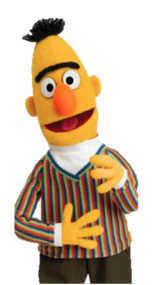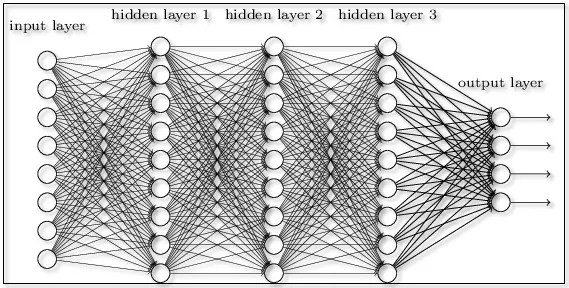

In [ ]:
import torch
import torch.nn as nn
from transformers import BertModel

class NewsClassifier(nn.Module):
    def __init__(self, num_classes=3, device=None):
        super(NewsClassifier, self).__init__()
        self.device = device if device is not None else torch.device('cpu')


        # Load pre-trained BERT model
        self.bert = BertModel.from_pretrained('bert-base-uncased')

        # Freeze BERT parameters
        for param in self.bert.parameters():
            param.requires_grad = False

        # Title-specific layers
        self.title_network = nn.Sequential(
            nn.Linear(768, 256),  # BERT output is 768-dimensional
            nn.ReLU(),
            nn.Dropout(0.3)
        )

        # Text-specific layers
        self.text_network = nn.Sequential(
            nn.Linear(768, 256),
            nn.ReLU(),
            nn.Dropout(0.3)
        )

        # Learnable weight for title importance
        self.title_weight = nn.Parameter(torch.tensor(0.3))

        # Final classification layer
        self.classifier = nn.Sequential(
            nn.Linear(512, 256),  # Combine title and text features
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(256, num_classes)
        )

        # Store token information for SHAP interpretation
        self.last_input_tokens = None
        self.last_token_embeddings = None

    def forward(self, title_input_ids, title_attention_mask,
                text_input_ids, text_attention_mask):

        # Store input tokens for potential later interpretation
        self.last_input_tokens = {
            'title_tokens': title_input_ids.to(self.device),
            'text_tokens': text_input_ids.to(self.device)
        }

        # Process title
        title_outputs = self.bert(
            input_ids=title_input_ids.to(self.device),
            attention_mask=title_attention_mask.to(self.device),
            output_hidden_states=True
        )
        # Use [CLS] token embedding
        title_cls = title_outputs.last_hidden_state[:, 0, :]
        title_features = self.title_network(title_cls)

        # Process text
        text_outputs = self.bert(
            input_ids=text_input_ids.to(self.device),
            attention_mask=text_attention_mask.to(self.device),
            output_hidden_states=True
        )
        # Use [CLS] token embedding
        text_cls = text_outputs.last_hidden_state[:, 0, :]
        text_features = self.text_network(text_cls)

        # Store full token embeddings for interpretation
        self.last_token_embeddings = {
            'title_embeddings': title_outputs.last_hidden_state.to(self.device),
            'text_embeddings': text_outputs.last_hidden_state.to(self.device)
        }

        # Weighted combination of features
        combined_features = torch.cat([
            self.title_weight * title_features,
            (1 - self.title_weight) * text_features
        ], dim=1)

        # Classify
        logits = self.classifier(combined_features)

        return logits

Preparing the training loop

**Loss Function is CrossEntropyLoss** for multi-class classification with an imbalanced dataset to punish mistakes from smaller classes.

Optimizer is **Adam**, with **Learning Rate 3e-5**, relatively high since learning is only for top layers above BERT (which is frozen). **Weight Decay is 5e-5** as an L2 regularization technique adding penalty for large weights.

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = NewsClassifier(num_classes=3, device=device)
model = model.to(device)
# Verify device
print("Model device:", next(model.parameters()).device)
print("Is model on correct device:", next(model.parameters()).device == device)
# Loss function
criterion = nn.CrossEntropyLoss()

# Collect trainable parameters
trainable_params = list(model.title_network.parameters()) + \
                   list(model.text_network.parameters()) + \
                   list(model.classifier.parameters()) + \
                   [model.title_weight]

# Optimizer
optimizer = optim.Adam(
    trainable_params,
    lr=2e-5,
    weight_decay=1e-5
)

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Model device: cuda:0
Is model on correct device: False


Print the architecture

In [ ]:
# Verify model components
print("Title Network:")
print(model.title_network)

print("\nText Network:")
print(model.text_network)

print("\nClassifier:")
print(model.classifier)

print("\nTitle Weight:")
print(model.title_weight)

Title Network:
Sequential(
  (0): Linear(in_features=768, out_features=256, bias=True)
  (1): ReLU()
  (2): Dropout(p=0.3, inplace=False)
)

Text Network:
Sequential(
  (0): Linear(in_features=768, out_features=256, bias=True)
  (1): ReLU()
  (2): Dropout(p=0.3, inplace=False)
)

Classifier:
Sequential(
  (0): Linear(in_features=512, out_features=256, bias=True)
  (1): ReLU()
  (2): Dropout(p=0.3, inplace=False)
  (3): Linear(in_features=256, out_features=3, bias=True)
)

Title Weight:
Parameter containing:
tensor(0.3000, device='cuda:0', requires_grad=True)


The Training Function for each epoch



In [ ]:
import torch
from tqdm import tqdm

def train_epoch(model, train_loader, criterion, optimizer, device):
    model.train()
    total_loss = 0
    correct_predictions = 0

    for batch in tqdm(train_loader, desc="Training"):
        optimizer.zero_grad()

        title_input_ids = batch['title_input_ids'].to(device)
        title_attention_mask = batch['title_attention_mask'].to(device)
        text_input_ids = batch['text_input_ids'].to(device)
        text_attention_mask = batch['text_attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(title_input_ids, title_attention_mask,
                        text_input_ids, text_attention_mask)

        loss = criterion(outputs, labels)
        total_loss += loss.item()

        _, preds = torch.max(outputs, dim=1)
        correct_predictions += torch.sum(preds == labels)

        loss.backward()
        optimizer.step()

    return total_loss / len(train_loader), correct_predictions.double() / len(train_loader.dataset)

The Evaluation Function

In [ ]:
def evaluate(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    correct_predictions = 0

    with torch.no_grad():
        for batch in data_loader:
            title_input_ids = batch['title_input_ids'].to(device)
            title_attention_mask = batch['title_attention_mask'].to(device)
            text_input_ids = batch['text_input_ids'].to(device)
            text_attention_mask = batch['text_attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(title_input_ids, title_attention_mask,
                            text_input_ids, text_attention_mask)

            loss = criterion(outputs, labels)
            total_loss += loss.item()

            _, preds = torch.max(outputs, dim=1)
            correct_predictions += torch.sum(preds == labels)

    return total_loss / len(data_loader), correct_predictions.double() / len(data_loader.dataset)

Learning Rate Scheduler, which reduces the LR (*0.1) when the validation loss stops improving for 3 epochs - in order to prevent overshooting the optimal solution when getting closer.

In [ ]:
from torch.optim.lr_scheduler import ReduceLROnPlateau

scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3, verbose=True)

Early Stopping - if no improvement after 5 epochs training will finish

In [ ]:
class EarlyStopping:
    def __init__(self, patience=5, min_delta=0.001):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')
        self.early_stop = False

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

# Initialize early stopping
early_stopping = EarlyStopping(patience=5, min_delta=0.001)

# Number of epochs
num_epochs = 35

A function to save model with smallest val loss

In [ ]:
import logging
import os
import torch

# Set up logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

def save_model(model, optimizer, epoch, val_loss, path):
    """
    Save the model state, optimizer state, epoch, and validation loss.
    """
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'val_loss': val_loss,
    }, path)
    logger.info(f"Model saved to {path}")

The full Model Training Loop Function, incorporating all previous components

In [ ]:
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs, device):
    logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
    logger = logging.getLogger(__name__)


    early_stopping = EarlyStopping(patience=5, min_delta=0.001)
    best_val_loss = float('inf')
    # History dictionary to track metrics
    history = {
        'train_loss': [],
        'train_acc': [],
        'val_loss': [],
        'val_acc': [],
        'title_weights': [],  # Track how title vs text importance changes
        'class_accuracies': {  # Track per-class performance
            'train': {'Israeli': [], 'Arab': [], 'Western': []},
            'val': {'Israeli': [], 'Arab': [], 'Western': []}
        }
    }
    for epoch in range(num_epochs):
        logger.info(f"Epoch {epoch+1}/{num_epochs}")

        train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device)
        logger.info(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}")

        val_loss, val_acc = evaluate(model, val_loader, criterion, device)
        logger.info(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}")

        # Tracking of title weight
        current_title_weight = model.title_weight.item()
        logger.info(f"Title Weight: {current_title_weight:.4f}")
        # Update history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        history['title_weights'].append(current_title_weight)
        scheduler.step(val_loss)

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            save_model(model, optimizer, epoch, val_loss, 'best_model.pth')

        early_stopping(val_loss)
        if early_stopping.early_stop:
            logger.info(f"Early stopping triggered at epoch {epoch+1}")
            break

        if (epoch + 1) % 10 == 0:
            save_model(model, optimizer, epoch, val_loss, f'model_epoch_{epoch+1}.pth')

    logger.info("Training completed")
    return model, best_val_loss, history

Checks before we start training

In [ ]:
print(f"Number of batches in train_loader: {len(train_loader)}")
print(f"Number of batches in val_loader: {len(val_loader)}")

# Check a sample batch
sample_batch = next(iter(train_loader))
print(f"Sample batch keys: {sample_batch.keys()}")
print(f"Sample input shape: {sample_batch['title_input_ids'].shape}")

Number of batches in train_loader: 624
Number of batches in val_loader: 156
Sample batch keys: dict_keys(['title_input_ids', 'title_attention_mask', 'text_input_ids', 'text_attention_mask', 'label'])
Sample input shape: torch.Size([16, 40])


In [ ]:
print(f"Optimizer: {type(optimizer).__name__}")
print(f"Initial learning rate: {optimizer.param_groups[0]['lr']}")
print(f"Scheduler: {type(scheduler).__name__}")

Optimizer: Adam
Initial learning rate: 2e-05
Scheduler: ReduceLROnPlateau


In [ ]:
print(f"Loss function: {criterion}")

Loss function: CrossEntropyLoss()


In [ ]:
print(f"Using device: {device}")
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"CUDA device: {torch.cuda.get_device_name(0)}")

Using device: cuda
CUDA available: True
CUDA device: Tesla T4


In [ ]:
print(f"Number of epochs: {num_epochs}")
print(f"Early stopping patience: {early_stopping.patience}")
print(f"Early stopping min delta: {early_stopping.min_delta}")

Number of epochs: 35
Early stopping patience: 5
Early stopping min delta: 0.001


In [ ]:
model.eval()
with torch.no_grad():
    batch = next(iter(train_loader))
    title_input_ids = batch['title_input_ids'].to(device)
    title_attention_mask = batch['title_attention_mask'].to(device)
    text_input_ids = batch['text_input_ids'].to(device)
    text_attention_mask = batch['text_attention_mask'].to(device)

    outputs = model(title_input_ids, title_attention_mask,
                    text_input_ids, text_attention_mask)
    print(f"Output device: {outputs.device}")

Output device: cuda:0


In [ ]:
# Explicitly move each component to the device
model.bert = model.bert.to(device)
model.title_network = model.title_network.to(device)
model.text_network = model.text_network.to(device)
model.classifier = model.classifier.to(device)


title_weight device: cuda:0
bert.embeddings.word_embeddings.weight device: cuda:0
bert.embeddings.position_embeddings.weight device: cuda:0
bert.embeddings.token_type_embeddings.weight device: cuda:0
bert.embeddings.LayerNorm.weight device: cuda:0
bert.embeddings.LayerNorm.bias device: cuda:0
bert.encoder.layer.0.attention.self.query.weight device: cuda:0
bert.encoder.layer.0.attention.self.query.bias device: cuda:0
bert.encoder.layer.0.attention.self.key.weight device: cuda:0
bert.encoder.layer.0.attention.self.key.bias device: cuda:0
bert.encoder.layer.0.attention.self.value.weight device: cuda:0
bert.encoder.layer.0.attention.self.value.bias device: cuda:0
bert.encoder.layer.0.attention.output.dense.weight device: cuda:0
bert.encoder.layer.0.attention.output.dense.bias device: cuda:0
bert.encoder.layer.0.attention.output.LayerNorm.weight device: cuda:0
bert.encoder.layer.0.attention.output.LayerNorm.bias device: cuda:0
bert.encoder.layer.0.intermediate.dense.weight device: cuda:0
be

Visualizations tracking training performance

In [ ]:
def plot_training_results(history):
    # Create a 2x2 subplot figure
    plt.figure(figsize=(15, 10))

    # Plot 1: Training and Validation Loss
    plt.subplot(2, 2, 1)
    train_loss = [x.cpu().item() if torch.is_tensor(x) else x for x in history['train_loss']]
    val_loss = [x.cpu().item() if torch.is_tensor(x) else x for x in history['val_loss']]
    plt.plot(train_loss, label='Train Loss')
    plt.plot(val_loss, label='Val Loss')
    plt.title('Loss Over Time')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

    # Plot 2: Training and Validation Accuracy
    plt.subplot(2, 2, 2)
    train_acc = [x.cpu().item() if torch.is_tensor(x) else x for x in history['train_acc']]
    val_acc = [x.cpu().item() if torch.is_tensor(x) else x for x in history['val_acc']]
    plt.plot(train_acc, label='Train Acc')
    plt.plot(val_acc, label='Val Acc')
    plt.title('Accuracy Over Time')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)

    # Plot 3: Title Weight Evolution
    plt.subplot(2, 2, 3)
    title_weights = [x.cpu().item() if torch.is_tensor(x) else x for x in history['title_weights']]
    plt.plot(title_weights)
    plt.title('Title vs Text Weight Evolution')
    plt.xlabel('Epoch')
    plt.ylabel('Title Weight')
    plt.axhline(y=0.3, color='r', linestyle='--', label='Initial Weight (0.3)')
    plt.grid(True)
    plt.legend()

    # Plot 4: Learning Rate Changes
    if 'learning_rates' in history:
        plt.subplot(2, 2, 4)
        plt.plot(history['learning_rates'])
        plt.title('Learning Rate Over Time')
        plt.xlabel('Epoch')
        plt.ylabel('Learning Rate')
        plt.yscale('log')
        plt.grid(True)

    plt.tight_layout()
    plt.show()

**TRAINING STARTS**

In [ ]:
# First verify CUDA and move model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Move model to GPU
model = model.to(device)

# Verify model is on correct device
print(f"Model is on correct device: {next(model.parameters()).device}")

# If using CUDA, check GPU memory before starting
if torch.cuda.is_available():
    print('Initial GPU Memory:')
    print('Allocated:', round(torch.cuda.memory_allocated(0)/1024**3,1), 'GB')
    print('Cached:   ', round(torch.cuda.memory_reserved(0)/1024**3,1), 'GB')

# Start training
print("\nStarting training...")

model, best_val_loss, history = train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    num_epochs=num_epochs,
    device=device
)

Using device: cuda
Model is on correct device: cuda:0
Initial GPU Memory:
Allocated: 0.4 GB
Cached:    1.0 GB

Starting training...


Training: 100%|██████████| 624/624 [05:12<00:00,  2.00it/s]


**Training results**

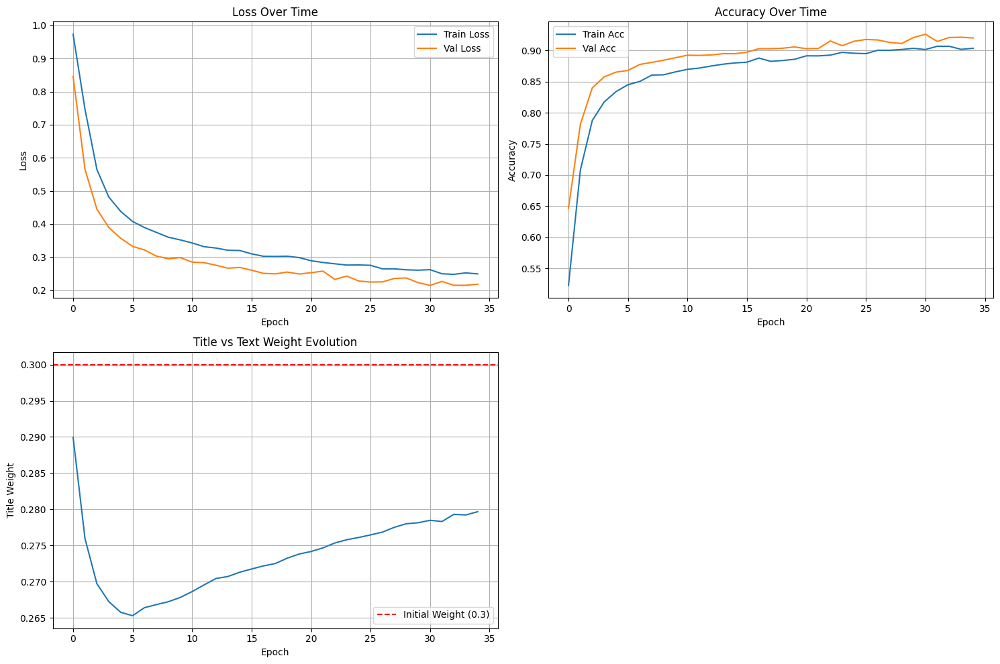

In [ ]:
plot_training_results(history)

**Confusion matrix**

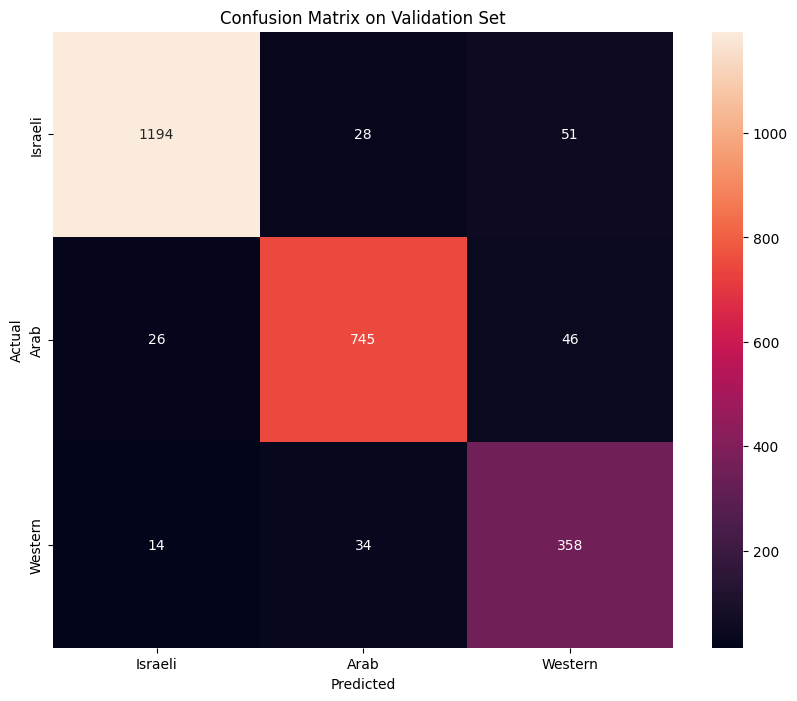


Class-wise Accuracy:
Israeli: 0.938
Arab: 0.912
Western: 0.882

Overall Accuracy: 0.911


In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(model, val_loader, device):
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch in val_loader:
            # Get data from batch
            title_input_ids = batch['title_input_ids'].to(device)
            title_attention_mask = batch['title_attention_mask'].to(device)
            text_input_ids = batch['text_input_ids'].to(device)
            text_attention_mask = batch['text_attention_mask'].to(device)
            labels = batch['label']

            # Get predictions
            outputs = model(title_input_ids, title_attention_mask,
                          text_input_ids, text_attention_mask)
            _, preds = torch.max(outputs, dim=1)

            # Move to CPU and convert to numpy
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # Create confusion matrix
    cm = confusion_matrix(all_labels, all_preds)

    # Plot
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d',
                xticklabels=['Israeli', 'Arab', 'Western'],
                yticklabels=['Israeli', 'Arab', 'Western'])
    plt.title('Confusion Matrix on Validation Set')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

    # Calculate accuracy for each class
    class_acc = cm.diagonal() / cm.sum(axis=1)
    print("\nClass-wise Accuracy:")
    print(f"Israeli: {class_acc[0]:.3f}")
    print(f"Arab: {class_acc[1]:.3f}")
    print(f"Western: {class_acc[2]:.3f}")
    print(f"\nOverall Accuracy: {np.mean(class_acc):.3f}")

# Run it
plot_confusion_matrix(model, val_loader, device)

In [ ]:
!free -h

               total        used        free      shared  buff/cache   available
Mem:            12Gi       2.7Gi       141Mi        15Mi       9.9Gi       9.7Gi
Swap:             0B          0B          0B


**SHAP Analysis**

In [ ]:
pip install shap

In [ ]:
# Ensure the model is on the GPU
device = torch.device('cuda:0')
model = model.to(device)

In [ ]:
import shap
import numpy as np
import pandas as pd
import torch
from typing import List, Tuple, Dict

def analyze_news_with_importance(X_title_val, X_text_val, y_val, model, tokenizer, device, n_samples: int = 200):
    """
    Analyze news articles using word removal importance on a representative sample
    """
    print("Preparing data...")
    # Get stratified sample to maintain class distribution
    class_indices = {}
    samples_per_class = n_samples // 3  # Split samples equally among classes

    for class_label in range(3):
        class_mask = y_val == class_label
        class_idx = np.where(class_mask)[0]
        selected = np.random.choice(class_idx, size=samples_per_class, replace=False)
        class_indices[class_label] = selected

    # Combine all selected indices
    indices = np.concatenate(list(class_indices.values()))
    np.random.shuffle(indices)  # Shuffle to mix classes

    titles = X_title_val.iloc[indices].tolist()
    texts = X_text_val.iloc[indices].tolist()
    labels = y_val.iloc[indices].tolist()

    # Create predictor
    predictor = DualBertWrapper(model, tokenizer, device)

    class_names = ['Israeli', 'Arab', 'Western']

    print(f"\nAnalyzing {n_samples} articles...")
    print(f"Class distribution in sample:")
    for class_label in range(3):
        count = sum(1 for l in labels if l == class_label)
        print(f"{class_names[class_label]}: {count} articles")

    # Analyze all examples
    results = []
    for idx in range(len(titles)):
        if idx % 10 == 0:  # Progress update
            print(f"Processing article {idx+1}/{len(titles)}")

        title = titles[idx]
        text = texts[idx]
        true_label = labels[idx]

        # Get importance scores
        importance_scores, predicted_class, confidence = analyze_importance(title, text, predictor)

        # Store results
        results.append({
            'index': idx,
            'title': title,
            'text_preview': text[:200],
            'true_class': class_names[true_label],
            'predicted_class': class_names[predicted_class],
            'confidence': confidence,
            'importance_scores': importance_scores
        })

        # Print detailed analysis for first 10 examples
        if idx < 10:
            print(f"\nExample {idx + 1}:")
            print("Title:", title)
            print("Text:", text[:200] + "...")
            print(f"True class: {class_names[true_label]}")
            print(f"Predicted class: {class_names[predicted_class]}")
            print(f"Confidence: {confidence:.4f}")

            print("\nMost important words:")
            for word, importance in importance_scores[:10]:
                impact = "positive" if importance > 0 else "negative"
                print(f"- {word}: {importance:.4f} ({impact} impact)")
            print("="*50)

    # Print summary statistics
    print("\nOverall Analysis:")
    accuracy = sum(1 for r in results if r['true_class'] == r['predicted_class']) / len(results)
    print(f"Accuracy on sample: {accuracy:.4f}")

    # Most important words by class
    print("\nMost important words by class:")
    for class_name in class_names:
        class_results = [r for r in results if r['predicted_class'] == class_name]
        all_words = []
        for r in class_results:
            all_words.extend(r['importance_scores'][:5])  # Top 5 words from each article

        # Get most common important words
        word_importance = {}
        for word, importance in all_words:
            if word not in word_importance:
                word_importance[word] = []
            word_importance[word].append(abs(importance))

        avg_importance = {word: np.mean(scores) for word, scores in word_importance.items()}
        top_words = sorted(avg_importance.items(), key=lambda x: x[1], reverse=True)[:10]

        print(f"\n{class_name} class top words:")
        for word, importance in top_words:
            print(f"- {word}: {importance:.4f}")

    return results


In [ ]:
# Run the analysis
print("Starting importance analysis...")
results = analyze_news_with_importance(X_title_val, X_text_val, y_val, model, tokenizer, device, n_samples=200)

Starting importance analysis...
Preparing data...

Analyzing 200 articles...
Class distribution in sample:
Israeli: 66 articles
Arab: 66 articles
Western: 66 articles
Processing article 1/198

Example 1:
Title: Israel approves delivery of diesel fuel for UN trucks in Gaza: Report
Text: Citing an unnamed humanitarian source, the Reuters news agency reported that Israel approved the entry of 24,000 litres (6,340 gallons) of diesel for UN trucks in Gaza.
The report comes after UNWRA, t...
True class: Arab
Predicted class: Arab
Confidence: 0.8962

Most important words:
- title: Gaza:: 0.1202 (positive impact)
- text: Hamas: -0.0829 (negative impact)
- text: trucks: -0.0789 (negative impact)
- text: fuel: -0.0759 (negative impact)
- text: report.: -0.0757 (negative impact)
- text: war.: -0.0749 (negative impact)
- text: not: -0.0712 (negative impact)
- text: fuel: -0.0711 (negative impact)
- text: did: -0.0709 (negative impact)
- text: Gaza.: -0.0707 (negative impact)

Example 2:
Title: At 

In [ ]:
import numpy as np
import torch
import pickle
from typing import List, Tuple, Dict

class DualBertWrapper:
    def __init__(self, model, tokenizer, device):
        self.model = model
        self.tokenizer = tokenizer
        self.device = device
        self.max_title_length = 40
        self.max_text_length = 469

    def __call__(self, title_text_pairs):
        if isinstance(title_text_pairs[0], str):
            title_text_pairs = [title_text_pairs]

        titles, texts = zip(*title_text_pairs)

        # Tokenize titles and texts
        title_encoded = self.tokenizer(
            list(titles),
            padding='max_length',
            truncation=True,
            max_length=self.max_title_length,
            return_tensors='pt'
        )

        text_encoded = self.tokenizer(
            list(texts),
            padding='max_length',
            truncation=True,
            max_length=self.max_text_length,
            return_tensors='pt'
        )

        title_input_ids = title_encoded['input_ids'].to(self.device)
        title_attention_mask = title_encoded['attention_mask'].to(self.device)
        text_input_ids = text_encoded['input_ids'].to(self.device)
        text_attention_mask = text_encoded['attention_mask'].to(self.device)

        with torch.no_grad():
            outputs = self.model(
                title_input_ids,
                title_attention_mask,
                text_input_ids,
                text_attention_mask
            )
            probas = torch.softmax(outputs, dim=1)

        return probas.cpu().numpy()

def analyze_news_with_importance(X_title_val, X_text_val, y_val, model, tokenizer, device, n_samples: int = 200):
    """
    Analyze news articles using word removal importance on a representative sample
    """
    print("Preparing data...")
    # Get stratified sample to maintain class distribution
    class_indices = {}
    samples_per_class = n_samples // 3  # Split samples equally among classes

    for class_label in range(3):
        class_mask = y_val == class_label
        class_idx = np.where(class_mask)[0]
        selected = np.random.choice(class_idx, size=samples_per_class, replace=False)
        class_indices[class_label] = selected

    # Combine all selected indices
    indices = np.concatenate(list(class_indices.values()))
    np.random.shuffle(indices)  # Shuffle to mix classes

    titles = X_title_val.iloc[indices].tolist()
    texts = X_text_val.iloc[indices].tolist()
    labels = y_val.iloc[indices].tolist()

    # Create predictor
    predictor = DualBertWrapper(model, tokenizer, device)

    class_names = ['Israeli', 'Arab', 'Western']

    print(f"\nAnalyzing {n_samples} articles...")
    print(f"Class distribution in sample:")
    for class_label in range(3):
        count = sum(1 for l in labels if l == class_label)
        print(f"{class_names[class_label]}: {count} articles")

    # Analyze importance for entire sample
    results = []
    overall_word_importance = {cls: {} for cls in class_names}

    for idx in range(len(titles)):
        if idx % 10 == 0:  # Progress update
            print(f"Processing article {idx+1}/{len(titles)}")

        title = titles[idx]
        text = texts[idx]
        true_label = labels[idx]

        # Baseline prediction
        base_pred = predictor([(title, text)])
        predicted_class = np.argmax(base_pred[0])
        confidence = base_pred[0][predicted_class]
        pred_class_name = class_names[predicted_class]

        # Analyze words by removing them and checking prediction change
        title_words = title.split()
        text_words = text.split()

        importance_scores = []

        # Analyze title words
        for word in title_words:
            modified_title = ' '.join([w if w != word else '[MASK]' for w in title_words])
            mod_pred = predictor([(modified_title, text)])
            mod_score = mod_pred[0][predicted_class]
            importance = confidence - mod_score
            importance_scores.append((f'title: {word}', importance))

        # Analyze text words
        for word in text_words:
            modified_text = ' '.join([w if w != word else '[MASK]' for w in text_words])
            mod_pred = predictor([(title, modified_text)])
            mod_score = mod_pred[0][predicted_class]
            importance = confidence - mod_score
            importance_scores.append((f'text: {word}', importance))

        # Sort importance scores
        importance_scores.sort(key=lambda x: abs(x[1]), reverse=True)

        # Accumulate word importance for the predicted class
        for word, importance in importance_scores[:10]:  # Top 10 words
            if word not in overall_word_importance[pred_class_name]:
                overall_word_importance[pred_class_name][word] = []
            overall_word_importance[pred_class_name][word].append(abs(importance))

        # Store results
        results.append({
            'title': title,
            'text': text,
            'true_class': class_names[true_label],
            'predicted_class': pred_class_name,
            'confidence': confidence,
            'importance_scores': importance_scores
        })

    # Aggregate word importance
    aggregated_importance = {}
    for cls in class_names:
        aggregated_importance[cls] = {}
        for word, importances in overall_word_importance[cls].items():
            aggregated_importance[cls][word] = np.mean(importances)

    # Print top words for each class
    print("\nMost important words by class:")
    for cls in class_names:
        top_words = sorted(aggregated_importance[cls].items(), key=lambda x: x[1], reverse=True)[:10]
        print(f"\n{cls} class top words:")
        for word, importance in top_words:
            print(f"- {word}: {importance:.4f}")

    # Calculate accuracy
    accuracy = sum(1 for r in results if r['true_class'] == r['predicted_class']) / len(results)
    print(f"\nOverall Accuracy: {accuracy:.4f}")

    return results

In [ ]:
# Usage
results = analyze_news_with_importance(X_title_val, X_text_val, y_val, model, tokenizer, device, n_samples=200)

Preparing data...

Analyzing 200 articles...
Class distribution in sample:
Israeli: 66 articles
Arab: 66 articles
Western: 66 articles
Processing article 1/198
Processing article 11/198
Processing article 21/198
Processing article 31/198
Processing article 41/198
Processing article 51/198
Processing article 61/198
Processing article 71/198
Processing article 81/198
Processing article 91/198
Processing article 101/198
Processing article 111/198
Processing article 121/198
Processing article 131/198
Processing article 141/198
Processing article 151/198
Processing article 161/198
Processing article 171/198
Processing article 181/198
Processing article 191/198

Most important words by class:

Israeli class top words:
- text: orderlies.”: 0.8936
- text: Holocaust: 0.7147
- text: Pistorius: 0.5952
- text: “as: 0.4780
- text: Vashem: 0.4683
- text: Hamas’s: 0.4567
- text: people.”: 0.4527
- text: defense: 0.4422
- text: were: 0.3976
- text: says.: 0.3771

Arab class top words:
- text: morning,

**Visualizations of Results**

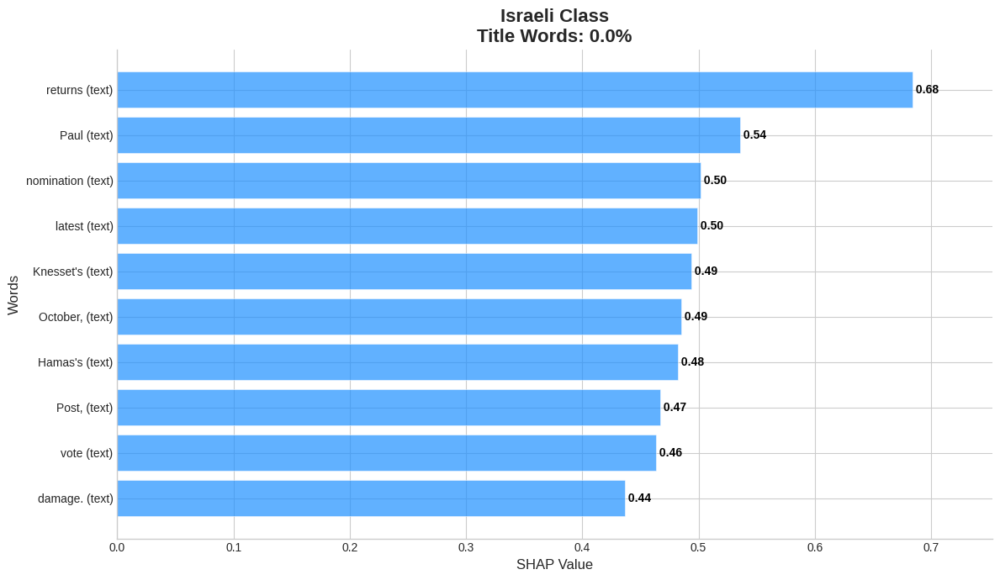

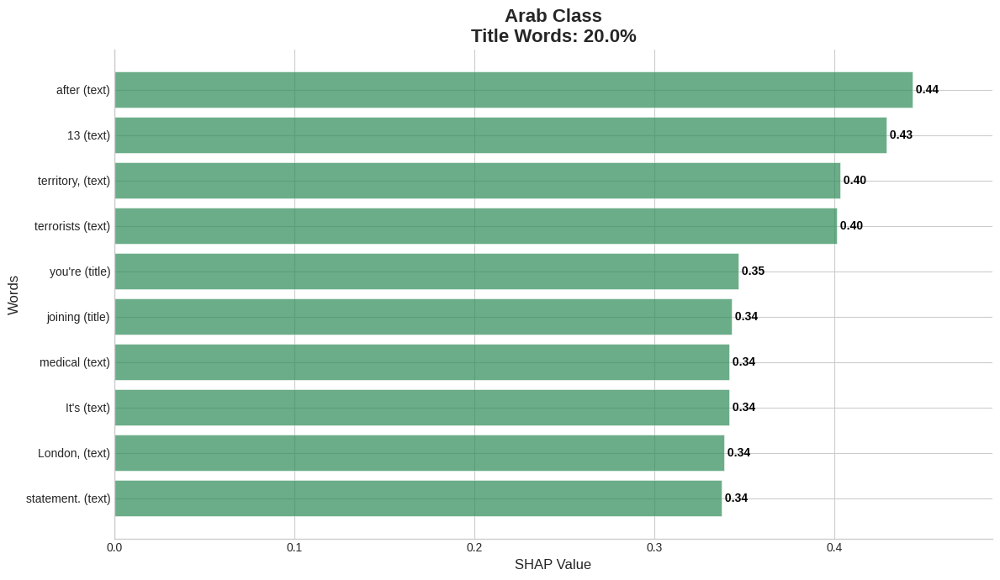

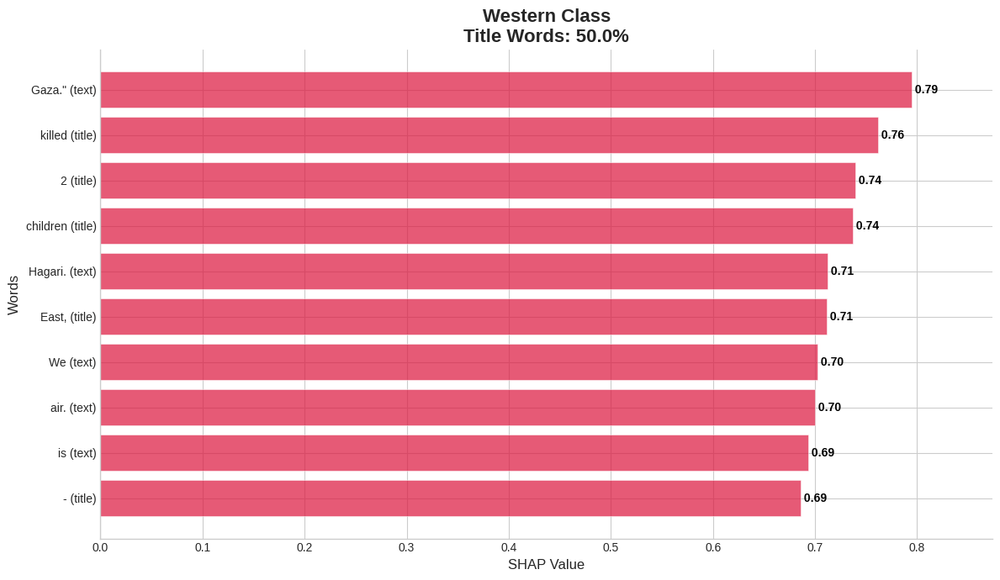


Israeli Class:
Mean SHAP Value: 0.5049
Highest SHAP Value Word: (0.6843, 'returns', 'text')

Arab Class:
Mean SHAP Value: 0.3725
Highest SHAP Value Word: (0.4434, 'after', 'text')

Western Class:
Mean SHAP Value: 0.7238
Highest SHAP Value Word: (0.7944, 'Gaza."', 'text')


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style to a clean, modern look
plt.style.use('seaborn-v0_8-whitegrid')

def visualize_word_importance(class_name, words):
   # Define color palette
   colors = {
       'Israeli': '#1E90FF',  # Dodger Blue
       'Arab': '#2E8B57',     # Sea Green
       'Western': '#DC143C'   # Crimson
   }

   # Create figure
   plt.figure(figsize=(12, 7))

   # Sort words by importance in descending order
   sorted_words = sorted(words, key=lambda x: x[0], reverse=True)

   # Calculate percentage of title words
   title_words = [word for _, word, source in sorted_words if source == 'title']
   title_percentage = (len(title_words) / len(sorted_words)) * 100

   # Extract words and importances
   word_labels = [f"{word} ({source})" for _, word, source in sorted_words]
   importances = [importance for importance, _, _ in sorted_words]

   # Create horizontal bar plot with improved aesthetics
   bars = plt.barh(word_labels, importances,
                    color=colors[class_name],
                    alpha=0.7,
                    edgecolor='white',
                    linewidth=0.5)

   # Customize plot
   plt.title(f'{class_name} Class\nTitle Words: {title_percentage:.1f}%', fontsize=16, fontweight='bold')
   plt.xlabel('SHAP Value', fontsize=12)
   plt.ylabel('Words', fontsize=12)

   # Add importance values at the end of each bar
   for j, v in enumerate(importances):
       plt.text(v, j, f' {v:.2f}',
                va='center',
                fontsize=10,
                color='black',
                fontweight='bold')

   # Invert y-axis to have top words at the top
   plt.gca().invert_yaxis()

   # Style improvements
   plt.gca().spines['top'].set_visible(False)
   plt.gca().spines['right'].set_visible(False)
   plt.tick_params(axis='both', which='major', labelsize=10)

   # Extend x-axis slightly to accommodate text
   plt.xlim(0, max(importances) * 1.1)

   # Overall figure aesthetics
   plt.tight_layout()
   plt.gcf().patch.set_facecolor('white')

   # Display the plot
   plt.show()

# Prepare the data
class_words = {
   'Israeli': [
       (0.6843, 'returns', 'text'),
       (0.5354, 'Paul', 'text'),
       (0.5018, 'nomination', 'text'),
       (0.4989, 'latest', 'text'),
       (0.4941, 'Knesset\'s', 'text'),
       (0.4851, 'October,', 'text'),
       (0.4824, 'Hamas\'s', 'text'),
       (0.4668, 'Post,', 'text'),
       (0.4636, 'vote', 'text'),
       (0.4365, 'damage.', 'text')
   ],
   'Arab': [
       (0.4434, 'after', 'text'),
       (0.4288, '13', 'text'),
       (0.4030, 'territory,', 'text'),
       (0.4014, 'terrorists', 'text'),
       (0.3468, 'you\'re', 'title'),
       (0.3430, 'joining', 'title'),
       (0.3417, 'medical', 'text'),
       (0.3415, 'It\'s', 'text'),
       (0.3386, 'London,', 'text'),
       (0.3373, 'statement.', 'text')
   ],
   'Western': [
       (0.7944, 'Gaza."', 'text'),
       (0.7619, 'killed', 'title'),
       (0.7395, '2', 'title'),
       (0.7371, 'children', 'title'),
       (0.7122, 'Hagari.', 'text'),
       (0.7119, 'East,', 'title'),
       (0.7024, 'We', 'text'),
       (0.6996, 'air.', 'text'),
       (0.6935, 'is', 'text'),
       (0.6857, '-', 'title')
   ]
}

# Example usage (can be used separately for each class)
for class_name, words in class_words.items():
   visualize_word_importance(class_name, words)

# Optional: print out some statistics
for cls, words in class_words.items():
   print(f"\n{cls} Class:")
   print(f"Mean SHAP Value: {sum(importance for importance, _, _ in words)/len(words):.4f}")
   print(f"Highest SHAP Value Word: {max(words, key=lambda x: x[0])}")

**Analysis on Israeli Results:**
- **"nomination," "Knesset’s," "vote":** an emphasis on political terminology indicates coverage of governmental responses and political dynamics in reaction to the conflict.
- **"Hamas’s," "October," "Post":** the terms "Hamas’s", and “October” directly relate to the actions and timing of the conflict’s eruption, and “Post” could refer to publications or reports following the attacks.
- **"damage", “returns,”:** likely pertain to reports on the destruction in Israel (infrastructure and civilian areas), and to either hostage return efforts or Israeli civilians returning from abroad

The focus is the internal political and civilian situation post October 7th

**Analysis on Arab Results:**
- **"terrorists“:** the portrayal of Israeli forces or quotation of Israeli statements.
- **"territory“:** discussions on land and sovereignty issues.
- **"Medical“:** a focus on healthcare crises
- **"statement“:** official communications or declarations.
- **"13“:** could reference specific casualty figures (YR – indeed, from November 11th).
- **"London“:** Pro-Palestinian demonstration of 300K in November 11th (YR)
- **"After“ and "It’s“:** common words that could appear in various contexts
- **"you're," "joining"** (title): may indicate call to action or aim at engaging readers

A focus on humanitarian concerns, territorial sovereignity, and int'l responses

**Analysis on Western Results:**
- **"killed," (title), "2"(title), "children" (title), "air" (text):** highlight casualty reports (YR - from air bombings), focusing on children impacted.
- **"Gaza.":** indicates a focus on the region (YR – more than on Israel)
- **"Hagari.":** suggests reliance on official military updates.
**"We," "is,":** common in reporting, possibly reflecting direct quotations.
- **"East", and “-”:** probably refer to "Middle-East,".

Western titles prominently feature casualty figures, aiming to capture reader attention and convey the gravity of the situation, and emphasizing the human cost.

**Task 1: Conclusions**

 - **Largely, Israel deals with the internal outcomes of October 7th, while Arab and Western media are focused on the war in Gaza**
 - **However, the short time-frame inhibits generalization of key words, focusing the model instead on salient but temporal events**

# **Task 2: Fine-tuning for Headline Generation**

 - **Fine-tune a pre-trained model to generate headlines from articles of different sources (Israeli/Arab/Western), with the real headline as label**
 - **Generate different source styles headlines for 5 new factual texts**

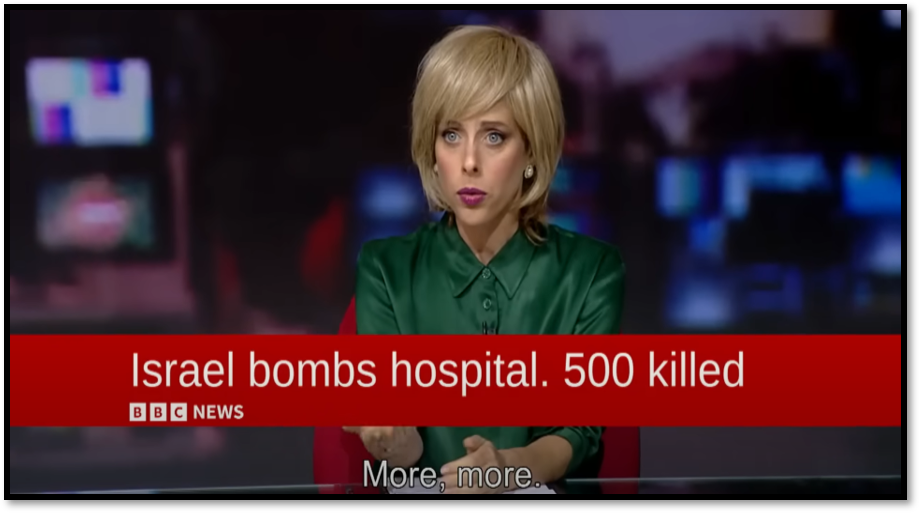

**Approach 1: Source Token Addition Mapped source categories to special tokens and prepended them to the text.**

**data preparation**


**Text Cleaning:**

 - Removed URLs from the text

 - Standardized quotes (smart quotes to regular quotes)

 - Removed special characters while keeping basic punctuation

 - Standardized spacing and removed extra whitespace

 - Applied this cleaning to the 'text' column in the DataFrame

In [29]:
from transformers import T5Tokenizer
import pandas as pd
import re

def clean_text(text):
    """
    Cleans text by removing special characters and standardizing spacing.
    """
    # Convert to string if not already
    text = str(text)

    # Remove URLs
    text = re.sub(r'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\\(\\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+', '', text)

    # Replace smart quotes with regular quotes
    text = text.replace('"', '"').replace('"', '"')
    text = text.replace(''', "'").replace(''', "'")

    # Remove extra whitespace and newlines
    text = ' '.join(text.split())

    # Remove other special characters but keep basic punctuation
    text = re.sub(r'[^\w\s.,!?\'\"()-]', '', text)

    # Fix multiple spaces
    text = re.sub(r'\s+', ' ', text)

    # Remove leading/trailing whitespace
    text = text.strip()

    return text

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]


**Source Token Addition**

 - Mapped source categories to special tokens:
Israeli -> [SOURCE: ISRAELI NEWS]
; Arab -> [SOURCE: ARAB NEWS]
; Western -> [SOURCE: WESTERN NEWS]

- Created a new 'sourced_text' column that prepends these tokens to the cleaned text

**Length Handling**

- Set maximum length to 508 tokens (accounting for T5-small's 512 token limit minus special tokens)
- Truncated longer texts to this limit
- Did not pad texts yet (will be handled by DataLoader during training)

**Validation**

- Confirmed correct source distribution (Israeli: 6,361, Arab: 4,086, Western: 2,030)
- Verified token length statistics (mean ~170, max 508, min 10)
Checked samples from each source category to ensure proper token prepending

In [74]:
class TextPreprocessor:
    def __init__(self):
        self.t5_tok = T5Tokenizer.from_pretrained('t5-small')
        self.source_tokens = {
            'Israeli': '[SOURCE: ISRAELI NEWS] ',
            'Arab': '[SOURCE: ARAB NEWS] ',
            'Western': '[SOURCE: WESTERN NEWS] '
        }

    def add_source_token(self, row):
        """Add source token to the beginning of the text."""
        token = self.source_tokens.get(row['source_category'], '')
        return token + str(row['text'])

    def process_text_length(self, text):
        """Process text to fit within T5's maximum length."""
        tokens = self.t5_tok.encode(
            text,
            truncation=True,
            max_length=508,
            padding=False
        )
        return self.t5_tok.decode(tokens, skip_special_tokens=True)

    def preprocess_dataframe(self, df):
        """
        Preprocesses the DataFrame by cleaning text and adding sourced_text column.
        Modifies df in place.
        """
        # First, let's verify the source categories
        print("Source category distribution:")
        print(df['source_category'].value_counts())
        print("\nStarting preprocessing...")

        # Clean the text column
        print("Cleaning text...")
        df['text'] = df['text'].apply(clean_text)

        # Add source tokens and process length
        print("Adding source tokens and processing text length...")
        df['sourced_text'] = df.apply(self.add_source_token, axis=1)
        df['sourced_text'] = df['sourced_text'].apply(self.process_text_length)

        # Print validation statistics
        print("\nValidation Statistics:")
        print(f"Number of samples: {len(df)}")

        # Token length statistics
        lengths = df['sourced_text'].apply(lambda x: len(self.t5_tok.encode(x)))
        print("\nToken length statistics:")
        print(f"Mean length: {lengths.mean():.2f}")
        print(f"Max length: {lengths.max()}")
        print(f"Min length: {lengths.min()}")
        print(f"95th percentile: {lengths.quantile(0.95):.0f}")

        # Sample verification
        print("\nSample texts by source (first 100 chars):")
        for source in df['source_category'].unique():
            sample = df[df['source_category'] == source]['sourced_text'].iloc[0]
            print(f"\n{source}:")
            print(f"{sample[:100]}...")



In [75]:
# Usage example:
preprocessor = TextPreprocessor()


spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.21k [00:00<?, ?B/s]

In [76]:
preprocessor.preprocess_dataframe(df)

Source category distribution:
source_category
Israeli    6361
Arab       4086
Western    2030
Name: count, dtype: int64

Starting preprocessing...
Cleaning text...
Adding source tokens and processing text length...

Validation Statistics:
Number of samples: 12477

Token length statistics:
Mean length: 176.70
Max length: 508
Min length: 17
95th percentile: 352

Sample texts by source (first 100 chars):

Western:
[SOURCE: WESTERN NEWS] Confusion over al-Shifa evacuation The director of Gaza City's largest hospit...

Israeli:
[SOURCE: ISRAELI NEWS] US President Joe Bidens main adviser on the Middle East says there will only ...

Arab:
[SOURCE: ARAB NEWS] Seventeen Palestinians have been arrested by Israeli forces in the occupied West...


The result is a df with a new 'sourced_text' column that contains cleaned, properly tokenized text with source identifiers, ready for the next steps of model training.

In [77]:
df.head()

,url,datetime,title,text,provider,source,text_length,source_category,sourced_text
0,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T18:05:00,A look at where things stand,Confusion over al-Shifa evacuation The directo...,BBC,site-live-news,1526,Western,[SOURCE: WESTERN NEWS] Confusion over al-Shifa...
1,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T17:36:00,'It's a nightmare for us',"Thousands of protesters shouted ""now, bring th...",BBC,site-live-news,874,Western,[SOURCE: WESTERN NEWS] Thousands of protesters...
2,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T17:18:00,Israeli army says it's expanding operations in...,A little earlier we reported on claims that a ...,BBC,site-live-news,888,Western,[SOURCE: WESTERN NEWS] A little earlier we rep...
3,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T16:57:00,Six weeks of war between Hamas in Gaza and Israel,"As evening sets in across Gaza, here's a small...",BBC,site-live-news,178,Western,[SOURCE: WESTERN NEWS] As evening sets in acro...
4,https://www.bbc.com/news/live/world-middle-eas...,2023-11-18T16:31:00,New UK foreign secretary speaks to Israeli cou...,"In the UK, the new Foreign Secretary David Cam...",BBC,site-live-news,629,Western,"[SOURCE: WESTERN NEWS] In the UK, the new Fore..."


**Dataset and DataLoader setup for T5 training**

Created a Custom Dataset Class (T5HeadlineDataset):

 - Takes sourced_text (input) and title (output) columns
 - Handles tokenization for both using T5 tokenizer
 - Sets appropriate maximum lengths: 508 tokens for sourced text (considering T5's 512 limit), 40 tokens for titles (optimized for headlines).
 - Returns tokenized tensors with proper masks

In [78]:
from torch.utils.data import Dataset, DataLoader
from transformers import T5Tokenizer
import torch
from sklearn.model_selection import train_test_split
import pandas as pd

class T5HeadlineDataset(Dataset):
    """
    Dataset for T5 headline generation task.
    Different name from NewsDataset to avoid conflicts.
    """
    def __init__(self, texts, titles, t5_tokenizer):
        self.texts = texts.reset_index(drop=True)
        self.titles = titles.reset_index(drop=True)
        self.t5_tokenizer = t5_tokenizer  # Different name from BERT tokenizer

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        # Get text and title
        text = str(self.texts.iloc[idx])
        title = str(self.titles.iloc[idx])

        # Tokenize input text
        stext_encoding = self.t5_tokenizer(
            text,
            max_length=508,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )

        # Tokenize title
        title_encoding = self.t5_tokenizer(
            title,
            max_length=40,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )

        return {
            'stext_ids': stext_encoding['input_ids'].flatten(),
            'stext_mask': stext_encoding['attention_mask'].flatten(),
            'title_ids': title_encoding['input_ids'].flatten(),
            'title_mask': title_encoding['attention_mask'].flatten()
        }

**Create DataLoaders:**

 - Batch size of 16
 - Proper padding handled within batches


 **Implemented Stratified Data Split:**

 - Split each source category (Israeli/Arab/Western) separately
 - Maintained 80-20 ratio for train-validation

In [79]:
def create_t5_dataloaders(df, t5_tokenizer, batch_size=16):
    """
    Creates train and validation dataloaders maintaining source distribution.
    """
    train_dfs = []
    val_dfs = []

    # Split each source category separately to maintain distribution
    for source in df['source_category'].unique():
        source_df = df[df['source_category'] == source]

        # 80-20 split for each source
        train_df, val_df = train_test_split(
            source_df,
            test_size=0.2,
            random_state=42
        )

        train_dfs.append(train_df)
        val_dfs.append(val_df)

    # Combine the splits
    train_df = pd.concat(train_dfs).reset_index(drop=True)
    val_df = pd.concat(val_dfs).reset_index(drop=True)

    # Create datasets
    train_dataset = T5HeadlineDataset(
        texts=train_df['sourced_text'],
        titles=train_df['title'],
        t5_tokenizer=t5_tokenizer
    )

    val_dataset = T5HeadlineDataset(
        texts=val_df['sourced_text'],
        titles=val_df['title'],
        t5_tokenizer=t5_tokenizer
    )

    # Create dataloaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2
    )

    # Print distribution statistics
    print("\nTraining Set Source Distribution:")
    print(train_df['source_category'].value_counts())
    print("\nValidation Set Source Distribution:")
    print(val_df['source_category'].value_counts())

    print(f"\nDataLoader Statistics:")
    print(f"Training samples: {len(train_dataset)}")
    print(f"Validation samples: {len(val_dataset)}")
    print(f"Number of training batches: {len(train_loader)}")
    print(f"Number of validation batches: {len(val_loader)}")

    # Verify a batch
    sample_batch = next(iter(train_loader))
    print("\nSample batch shapes:")
    for key, value in sample_batch.items():
        print(f"{key}: {value.shape}")

    return train_loader, val_loader

In [80]:

# Usage example:
# Initialize tokenizer
t5_tokenizer = T5Tokenizer.from_pretrained('t5-small')

In [81]:
# Create dataloaders
train_loader, val_loader = create_t5_dataloaders(
    df=df,
    t5_tokenizer=t5_tokenizer,
    batch_size=16
)


Training Set Source Distribution:
source_category
Israeli    5088
Arab       3268
Western    1624
Name: count, dtype: int64

Validation Set Source Distribution:
source_category
Israeli    1273
Arab        818
Western     406
Name: count, dtype: int64

DataLoader Statistics:
Training samples: 9980
Validation samples: 2497
Number of training batches: 624
Number of validation batches: 157

Sample batch shapes:
stext_ids: torch.Size([16, 508])
stext_mask: torch.Size([16, 508])
title_ids: torch.Size([16, 40])
title_mask: torch.Size([16, 40])



**Results verified:**
   - Training: Israeli (5088), Arab (3268), Western (1624)
   - Validation: Israeli (1273), Arab (818), Western (406)

**Verified Output Shapes:**

 - Sourced text: [16, 508] (batch × max_text_length)
 - Titles: [16, 40] (batch × max_title_length)
 - All tensors include proper attention masks

**Setting up training**

In [82]:
import torch
import torch.nn as nn
from transformers import T5ForConditionalGeneration, AdamW
from torch.optim import lr_scheduler
import logging
import json
import numpy as np
from collections import Counter
from typing import Dict, List, Any
import os

# Set up logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

In [83]:
def validate_dataloaders(train_loader, val_loader, t5_tokenizer):
    """
    Validates dataloader contents and prints detailed information.
    """
    print("Validating DataLoaders...")

    # Detailed train loader check
    print("\nTraining Loader Details:")
    print(f"Total batches: {len(train_loader)}")
    print(f"Batch size: {train_loader.batch_size}")

    # Sample check
    sample_batch = next(iter(train_loader))
    print("\nSample Batch:")
    for key, value in sample_batch.items():
        print(f"{key} shape: {value.shape}")

    # Decode a sample text to verify content
    sample_text = t5_tokenizer.decode(sample_batch['stext_ids'][0])
    sample_title = t5_tokenizer.decode(sample_batch['title_ids'][0])
    print("\nSample Text (first 100 chars):", sample_text[:100])
    print("Sample Title:", sample_title)

    # Validation loader check
    print("\nValidation Loader Details:")
    print(f"Total batches: {len(val_loader)}")
    print(f"Batch size: {val_loader.batch_size}")

**T5-small choice rationale:**

 - Pre-trained on diverse text tasks including summarization (close to headline generation)
 - Unified text-to-text format (simpler than encoder-only or decoder-only models)
 - Good performance/size ratio compared to BART or PEGASUS
 - Sufficient capacity for headline generation (60M parameters, ~35K lexicon), with fast training and inference, suitable for Colab

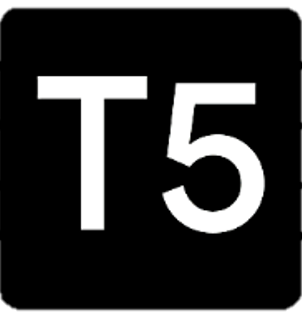

**Beam Search choice as generative function:**

 - **Purpose:** Find the most likely coherent headline by exploring multiple paths
 - **Better than pure sampling** (top k/p, temprature) for maintaining coherence and avoiding nonsensical text
 - **Length penalty of 2:** prevents extremely short headlines
 - **num beams of 4:** standard choice: balances exploration vs computation
 - **no repeat n-grams of 2:** prevents repetetive phrases


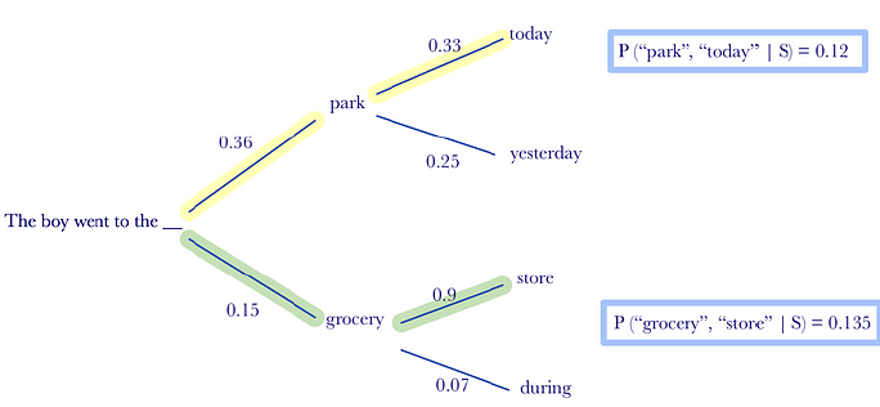

In [84]:
class HeadlineGeneratorT5(nn.Module):
    def __init__(self, model_name='t5-small', device='cuda'):
        super().__init__()
        self.device = device
        self.t5 = T5ForConditionalGeneration.from_pretrained(model_name).to(device)

    def forward(self, input_ids, attention_mask, labels=None):
        outputs = self.t5(
            input_ids=input_ids,
            attention_mask=attention_mask,
            labels=labels,
            return_dict=True
        )
        return outputs.loss if labels is not None else outputs.logits

    def generate_headlines(self, input_ids, attention_mask, max_length=40):
        return self.t5.generate(
            input_ids=input_ids,
            attention_mask=attention_mask,
            max_length=max_length,
            num_beams=4,
            length_penalty=2.0,
            early_stopping=True,
            no_repeat_ngram_size=2
        )

**Evaluation Metrics:**

- **loss**
- **Generated headline lengths distribution**
- **Common words:** captures characteristic in word choice

In [85]:
class T5Evaluator:
    def __init__(self, tokenizer):
        self.tokenizer = tokenizer
        self.reset_metrics()

    def reset_metrics(self):
        """Initialize/reset all metrics."""
        self.metrics = {
            'perplexity': [],
            'headline_lengths': [],
            'source_metrics': {
                'Israeli': {'lengths': [], 'vocab': Counter()},
                'Arab': {'lengths': [], 'vocab': Counter()},
                'Western': {'lengths': [], 'vocab': Counter()}
            }
        }

    def calculate_perplexity(self, loss: float) -> float:
        """Calculate perplexity from loss."""
        return float(np.exp(loss)) if not np.isnan(loss) else float('inf')

    def analyze_headline(self, headline: str, source: str):
        """Analyze a single generated headline."""
        if not headline or not source:
            return

        words = headline.split()
        if not words:
            return

        # Update source-specific metrics
        if source in self.metrics['source_metrics']:
            self.metrics['source_metrics'][source]['lengths'].append(len(words))
            self.metrics['source_metrics'][source]['vocab'].update(words)

        # Update general headline length distribution
        self.metrics['headline_lengths'].append(len(words))

    def get_summary_metrics(self) -> Dict[str, Any]:
        """Get summary of all collected metrics."""
        summary = {
            'perplexity': {},
            'headline_lengths': {},
            'source_analysis': {}
        }

        # Calculate perplexity stats if available
        if self.metrics['perplexity']:
            summary['perplexity'] = {
                'mean': float(np.mean(self.metrics['perplexity'])),
                'std': float(np.std(self.metrics['perplexity']))
            }

        # Calculate headline length stats if available
        if self.metrics['headline_lengths']:
            summary['headline_lengths'] = {
                'mean': float(np.mean(self.metrics['headline_lengths'])),
                'std': float(np.std(self.metrics['headline_lengths']))
            }

        # Per-source analysis
        for source in self.metrics['source_metrics']:
            lengths = self.metrics['source_metrics'][source]['lengths']
            vocab = self.metrics['source_metrics'][source]['vocab']

            if lengths:  # Only if we have data for this source
                summary['source_analysis'][source] = {
                    'avg_length': float(np.mean(lengths)),
                    'length_std': float(np.std(lengths)),
                    'vocab_size': len(vocab),
                    'most_common_words': dict(vocab.most_common(10))
                }

        return summary

In [86]:
class T5EarlyStopping:
    def __init__(self, patience=3, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0

In [87]:
def evaluate_t5(model, val_loader, device, evaluator, t5_tokenizer):
    """Enhanced evaluation with detailed source-specific analysis."""
    model.eval()
    total_loss = 0
    generated_headlines = []

    print("\nStarting comprehensive evaluation...")
    # Reset metrics for this evaluation
    evaluator.reset_metrics()

    with torch.no_grad():
        # Iterate through all validation batches
        for batch_idx, batch in enumerate(val_loader, 1):
            input_ids = batch['stext_ids'].to(device)
            attention_mask = batch['stext_mask'].to(device)
            labels = batch['title_ids'].to(device)

            # Replace padding tokens with -100 in labels
            labels[labels == t5_tokenizer.pad_token_id] = -100

            # Calculate loss
            loss = model(input_ids, attention_mask, labels)
            total_loss += loss.item()

            # Generate headlines for analysis
            generated_ids = model.generate_headlines(input_ids, attention_mask)
            texts = [t5_tokenizer.decode(g, skip_special_tokens=True) for g in generated_ids]

            # Analyze generated headlines
            for i, text in enumerate(texts):
                # Extract source token from input
                source_token = t5_tokenizer.decode(input_ids[i])[:5]
                source_mapping = {
                    '[ISR]': 'Israeli',
                    '[ARB]': 'Arab',
                    '[WST]': 'Western'
                }
                source = source_mapping.get(source_token, 'Unknown')

                # Analyze headline
                evaluator.analyze_headline(text, source)
                generated_headlines.append(text)

            # Periodic progress and sample generations
            if batch_idx % 50 == 0:
                print(f"Evaluated {batch_idx}/{len(val_loader)} batches")

                # Print sample generations
                print("\nSample Generations:")
                for i in range(min(2, len(texts))):
                    print(f"Source {source_token} - Sample {i+1}: {texts[i]}")

    # Calculate final validation loss
    val_loss = total_loss / len(val_loader)
    print(f"Validation completed - Loss: {val_loss:.4f}")

    # Get comprehensive summary metrics
    summary_metrics = evaluator.get_summary_metrics()

    # Print detailed analysis
    print("\nDetailed Evaluation Metrics:")
    print("Perplexity:", summary_metrics.get('perplexity', 'N/A'))
    print("Headline Lengths:", summary_metrics.get('headline_lengths', 'N/A'))

    print("\nSource-Specific Analysis:")
    for source, analysis in summary_metrics.get('source_analysis', {}).items():
        print(f"\n{source} Source:")
        print(f"  Average Headline Length: {analysis['avg_length']:.2f}")
        print(f"  Length Std Deviation: {analysis['length_std']:.2f}")
        print(f"  Vocabulary Size: {analysis['vocab_size']}")
        print("  Most Common Words:", analysis['most_common_words'])

    return val_loss, generated_headlines, summary_metrics

In [88]:
def save_t5_checkpoint(model, optimizer, tokenizer, evaluator, epoch, path):
    """Save all training components and metrics."""
    os.makedirs(path, exist_ok=True)

    checkpoint = {
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'metrics': evaluator.get_summary_metrics(),
        'generation_params': {
            'num_beams': 4,
            'length_penalty': 2.0,
            'no_repeat_ngram_size': 2,
            'max_length': 40
        }
    }

    # Save model checkpoint
    torch.save(checkpoint, f'{path}/model_checkpoint.pt')

    # Save tokenizer
    tokenizer.save_pretrained(f'{path}/tokenizer')

    # Save metrics separately for easy analysis
    with open(f'{path}/metrics.json', 'w') as f:
        json.dump(evaluator.get_summary_metrics(), f, indent=2)

    logger.info(f"Checkpoint saved to {path}")

**Hyper-parameters:**

 - **Learning rate 2e-5:** standard for fine-tuning T5, balances learning speed with stability
 - **AdamW optimizer:** Combines advantages of Adam (adaptive learning rates) with proper weight decay
 - **LR scheduler:** checks for plateau (loss hasn't improved by min_delta) after each epoch, and after patience (2 epochs) halves the LR
 - **L2 regularization with weight decay of 0.01:** prevents growing weight values
 - **Early stopping:** if plateau persists for 3 epochs
 - **5 epochs:** T5 is pre-trained and needs a small fine-tuning, and the dataset is large enough (~12,500 samples). Previous experiments show convergence by epoch 3-4.

In [89]:
def train_t5_epoch(model, train_loader, optimizer, device, evaluator):
    """Train for one epoch with detailed diagnostics."""
    model.train()
    total_loss = 0
    total_batches = len(train_loader)

    # Track parameter statistics before training
    initial_param_norms = {}
    for name, param in model.named_parameters():
        if param.requires_grad:
            initial_param_norms[name] = param.norm().item()

    print(f"\nTraining on {total_batches} batches...")
    for batch_idx, batch in enumerate(train_loader, 1):
        optimizer.zero_grad()

        # Get batch and move to device
        input_ids = batch['stext_ids'].to(device)
        attention_mask = batch['stext_mask'].to(device)
        labels = batch['title_ids'].to(device)

        # Replace padding tokens with -100 in labels
        labels[labels == t5_tokenizer.pad_token_id] = -100

        # Forward pass
        loss = model(input_ids, attention_mask, labels)

        # Backward pass
        loss.backward()

        # Optimizer step
        optimizer.step()

        # Update metrics
        batch_loss = loss.item()
        total_loss += batch_loss
        evaluator.metrics['perplexity'].append(evaluator.calculate_perplexity(batch_loss))

        # Periodic detailed logging
        if batch_idx % 50 == 0:
            print(f"\nBatch {batch_idx}/{total_batches}")
            print(f"Current Batch Loss: {batch_loss:.4f}")

            # Check parameter changes
            param_changes = {}
            for name, param in model.named_parameters():
                if param.grad is not None:
                    param_change = torch.norm(param.grad).item()
                    current_norm = param.norm().item()
                    initial_norm = initial_param_norms.get(name, 0)
                    param_changes[name] = {
                        'grad_norm': param_change,
                        'current_norm': current_norm,
                        'initial_norm': initial_norm
                    }

            # Print top 5 parameter changes
            sorted_changes = sorted(param_changes.items(),
                                    key=lambda x: x[1]['grad_norm'],
                                    reverse=True)
            print("\nTop 5 Parameter Gradient Changes:")
            for name, stats in sorted_changes[:5]:
                print(f"{name}:")
                print(f"  Grad Norm: {stats['grad_norm']:.6f}")
                print(f"  Current Norm: {stats['current_norm']:.6f}")
                print(f"  Initial Norm: {stats['initial_norm']:.6f}")

    epoch_loss = total_loss / total_batches
    print(f"\nEpoch completed - Average Loss: {epoch_loss:.4f}")
    return epoch_loss

In [90]:
def train_t5_model(model, train_loader, val_loader, t5_tokenizer,
                   device, num_epochs=5, checkpoint_dir='t5_checkpoints'):
    """Complete training pipeline with detailed logging."""
    print("\nInitializing training...")
    print(f"Device: {device}")
    print(f"Number of epochs: {num_epochs}")
    print(f"Training batches per epoch: {len(train_loader)}")
    print(f"Validation batches per epoch: {len(val_loader)}")

    # Initialize components
    optimizer = torch.optim.AdamW(model.parameters(), lr=2e-5, weight_decay=0.01)
    # Cosine Annealing Scheduler setup
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        optimizer,
        T_max=num_epochs * len(train_loader),  # Total training steps
        eta_min=5e-6  # Minimum learning rate
    )
    evaluator = T5Evaluator(t5_tokenizer)
    early_stopping = T5EarlyStopping(patience=3)

    best_val_loss = float('inf')
    os.makedirs(checkpoint_dir, exist_ok=True)

    print("\nStarting training loop...")
    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")
        print("-" * 50)

        # Train
        train_loss = train_t5_epoch(model, train_loader, optimizer, device, evaluator)
        print(f"Training Loss: {train_loss:.4f}")

        # Evaluate
        val_loss, generated_headlines, val_metrics = evaluate_t5(
            model, val_loader, device, evaluator, t5_tokenizer
        )
        print(f"Validation Loss: {val_loss:.4f}")

        # Optional: Log or save validation metrics
        with open(f'{checkpoint_dir}/validation_metrics.json', 'w') as f:
            json.dump(val_metrics, f, indent=2)

        # Learning rate scheduling
        scheduler.step()  # Step after each epoch
        current_lr = optimizer.param_groups[0]['lr']
        print(f"Current Learning Rate: {current_lr:.2e}")

        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            print(f"New best validation loss: {val_loss:.4f}")
            save_t5_checkpoint(
                model, optimizer, t5_tokenizer, evaluator,
                epoch, f"{checkpoint_dir}/best_model"
            )

        # Early stopping
        early_stopping(val_loss)
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break

        # Regular checkpoint
        if (epoch + 1) % 2 == 0:
            save_t5_checkpoint(
                model, optimizer, t5_tokenizer, evaluator,
                epoch, f"{checkpoint_dir}/epoch_{epoch+1}"
            )

    print("\nTraining completed!")
    return model, evaluator.get_summary_metrics()


In [91]:
# Usage example:

# Initialize model and move to device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = HeadlineGeneratorT5(device=device)


model.safetensors:   0%|          | 0.00/892M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/147 [00:00<?, ?B/s]

In [93]:
print("Starting full training...")
print("Model type:", type(model))
print("Model class:", model.__class__)

# Just before training, verify the forward method
model.forward = lambda input_ids, attention_mask, labels=None: model.t5(
    input_ids=input_ids,
    attention_mask=attention_mask,
    labels=labels,
    return_dict=True
).loss if labels is not None else model.t5(
    input_ids=input_ids,
    attention_mask=attention_mask,
    labels=labels,
    return_dict=True
).logits

trained_model, metrics = train_t5_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    t5_tokenizer=t5_tokenizer,
    device=device,
    num_epochs=5
)

Starting full training...
Model type: <class '__main__.HeadlineGeneratorT5'>
Model class: <class '__main__.HeadlineGeneratorT5'>

Initializing training...
Device: cuda
Number of epochs: 5
Training batches per epoch: 624
Validation batches per epoch: 157

Starting training loop...

Epoch 1/5
--------------------------------------------------

Training on 624 batches...


OutOfMemoryError: CUDA out of memory. Tried to allocate 24.00 MiB. GPU 0 has a total capacity of 14.74 GiB of which 24.12 MiB is free. Process 10728 has 14.71 GiB memory in use. Of the allocated memory 14.48 GiB is allocated by PyTorch, and 109.26 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
# Load checkpoint later:
#checkpoint = torch.load('t5_checkpoints/best_model/model_checkpoint.pt')
#model.load_state_dict(checkpoint['model_state_dict'])

Preparing the 5 articles

In [ ]:
from transformers import T5Tokenizer

# Initialize tokenizer
t5_tokenizer = T5Tokenizer.from_pretrained('t5-small')

# Source tokens
source_tokens = {
            'Israeli': '[SOURCE: ISRAELI NEWS]',
            'Arab': '[SOURCE: ARAB NEWS]',
            'Western': '[SOURCE: WESTERN NEWS]'
        }

# Texts (without headlines)
texts = [
    # Article 1
    "On April 13, 2024, Iran launched a major retaliatory strike against Israel, marking a dramatic escalation in the long-standing regional conflict. This followed an Israeli airstrike earlier that day on Iran's consulate in Damascus, Syria, which Israel claimed targeted a facility used by Iranian diplomats and military officials allegedly supporting regional militancy. Iran responded by firing a combination of ballistic missiles, drones, and cruise missiles at Israeli military targets, including air defense systems, airstrips, and communication hubs. Israel's Iron Dome and David's Sling intercepted several projectiles, but some missiles penetrated Israeli defenses, causing damage and casualties, particularly in northern Israel.\n\nIran's Ministry of Defense described the attack as a justified retaliation for Israel's aggression. Iranian officials emphasized that Israel's military actions in Syria, particularly against Iranian-backed groups like Hezbollah, had prompted their response. The Iranian government framed the strike as a defense of its sovereignty and an expression of its opposition to Israeli policies in the region.\n\nIsraeli officials condemned the Iranian assault, calling it an unprovoked attack on civilian and military infrastructure. Prime Minister Benjamin Netanyahu affirmed Israel's right to defend itself and vowed to retaliate against Iranian military assets in the region. The United States, a close ally of Israel, expressed firm support, pledging to bolster Israel's defense capabilities in the face of Iranian threats.\n\nThe international community expressed grave concerns over the escalating violence, with calls for both sides to de-escalate and engage in dialogue to avoid a broader regional conflict. Despite these calls for restraint, tensions between Israel and Iran continued to grow, with both nations making military preparations amid the volatile atmosphere.\n",

    # Article 2
    "On April 1, 2024, an Israeli drone strike targeted a convoy operated by World Central Kitchen (WCK) in Gaza, killing at least seven aid workers. The workers, who were distributing food and supplies to civilians in need, were traveling through a southern Gaza region known for Hamas military activity. The convoy was coordinated with the Israeli Defense Forces (IDF) to ensure safe passage through the conflict zone.\n\nThe IDF acknowledged responsibility for the attack, explaining that the convoy had been misidentified as a military target, given its proximity to Hamas-controlled areas. The Israeli government expressed regret over the deaths, claiming it was a tragic mistake in a highly fluid and dangerous environment. An internal IDF investigation was launched, resulting in the suspension of several officers.\n\nWorld Central Kitchen condemned the attack, calling for an independent investigation into the circumstances of the strike. The organization, which had been working to provide food relief in Gaza, suspended its operations in the region following the incident, citing the heightened risks for humanitarian workers in conflict zones. International humanitarian groups condemned the attack, calling for increased protections for aid workers in Gaza and other conflict areas.\n\nThe incident added to the already tense atmosphere in Gaza, where Israel's military operations had caused significant destruction. Both Israeli and Palestinian officials were criticized by the international community for their failure to protect civilian infrastructure and humanitarian workers. The attack highlighted the challenges of providing aid in a conflict zone while navigating complex military operations.\n",

    # Article 3
    "On May 6, 2024, Israeli forces launched a military operation in Rafah, a city in the southern Gaza Strip, as part of its ongoing campaign against Hamas. The IDF targeted Hamas's tunnel network, which it claims was used for smuggling weapons, fighters, and materials into Gaza. The operation, which involved ground troops and airstrikes, was described by the IDF as necessary to dismantle Hamas's military infrastructure and prevent further attacks on Israel.\n\nThe operation faced strong resistance from Hamas fighters, leading to intense clashes in urban areas. Palestinian sources reported heavy civilian casualties and widespread damage to infrastructure, including homes, schools, and hospitals. Gaza's health ministry stated that dozens of civilians were killed in the fighting, with many others wounded.\n\nIsraeli officials insisted that the operation was conducted in accordance with international law, emphasizing that Hamas's use of civilian areas for military purposes made it difficult to avoid collateral damage. They stressed that Hamas's militant activities posed a direct threat to Israeli civilians and that dismantling their network was essential for Israeli security.\n\nOn the other hand, Palestinian leaders condemned the operation, accusing Israel of committing war crimes by targeting civilian areas. The United Nations and various human rights organizations called for an immediate ceasefire and an independent investigation into the actions of both sides. Despite calls for restraint, the operation continued, contributing to the ongoing cycle of violence and destruction in Gaza.\n",

    # Article 4
    "On January 15, 2025, a ceasefire agreement was announced between Israel and Hamas, ending months of intense military operations in Gaza. The agreement was brokered by international mediators, including Egypt, Qatar, and the United States, and was set to take effect on January 19, 2025. Under the terms of the ceasefire, Israel agreed to withdraw its forces from Gaza, while Hamas committed to halting rocket fire into Israeli territory. Both sides also agreed to a prisoner exchange and the resumption of humanitarian aid into Gaza.\n\nIsraeli officials expressed cautious optimism about the ceasefire but warned that it would be contingent on Hamas's compliance. They emphasized the importance of monitoring Hamas's activities closely to prevent any rearming or renewed attacks. Israeli Prime Minister Netanyahu stated that Israel would not hesitate to take action if Hamas violated the terms of the ceasefire.\n\nHamas welcomed the ceasefire but made it clear that it would not end its resistance against Israel. The group's leaders emphasized that the ceasefire was a temporary measure and that their fight for Palestinian rights would continue. Despite the truce, both sides remained deeply distrustful of one another, and international analysts warned that the ceasefire could be fragile and subject to collapse.\n\nThe United Nations and other international bodies expressed cautious optimism about the ceasefire's potential to pave the way for long-term peace, though they acknowledged that the underlying issues of the Israeli-Palestinian conflict remained unresolved.\n",

    # Article 5
    "On February 4, 2025, U.S. President Donald Trump unveiled his long-awaited plan for Gaza, which he described as a 'bold and innovative solution' to the ongoing Israeli-Palestinian conflict. The plan proposed the relocation of Palestinian residents from Gaza to neighboring countries, particularly Egypt and Jordan, where they could receive better living conditions and opportunities for resettlement. Trump's plan also outlined a major reconstruction effort for Gaza, with U.S. leadership in clearing debris, rebuilding infrastructure, and providing humanitarian aid.\n\nThe plan immediately faced strong opposition from both Palestinian and regional Arab leaders. Egyptian officials rejected the proposal, stating that accepting large numbers of Palestinian refugees was unacceptable and would destabilize their country. Similarly, Jordan expressed concern about the strain the plan would place on its own refugee populations.\n\nPalestinian leaders, including those from Hamas and the Palestinian Authority, condemned the plan as a violation of their right to self-determination. They viewed it as an attempt to forcibly displace Palestinians from their land and an effort to sideline their aspirations for an independent state. Hamas vowed to continue its resistance to Israeli occupation, regardless of any external proposals.\n\nInternational reactions were mixed. Some analysts argued that the plan could bring much-needed attention to Gaza's dire humanitarian situation, while others criticized it as unrealistic and potentially harmful. Despite the backlash, the U.S. administration maintained that the plan would lead to a more stable and prosperous future for the region. However, with little support from key regional actors, its implementation remained uncertain.\n"
]

# Prepare texts with each source token
prepared_texts = {}
for source, token in source_tokens.items():
    prepared_texts[source] = [token + text for text in texts]

# Encode and decode to verify max length
for source, texts_list in prepared_texts.items():
    print(f"\n{source} Source Texts:")
    for i, text in enumerate(texts_list, 1):
        tokens = t5_tokenizer.encode(
            text,
            truncation=True,
            max_length=508,
            padding=False
        )
        decoded_text = t5_tokenizer.decode(tokens, skip_special_tokens=True)
        print(f"Article {i} - Token Count: {len(tokens)}")
        print(f"First 200 chars: {decoded_text[:200]}...\n")

In [ ]:
# Load the best model checkpoint
#best_checkpoint_path = 't5_checkpoints/best_model/model_checkpoint.pt'
#checkpoint = torch.load(best_checkpoint_path)

# Reinitialize the model with the saved weights
#model = HeadlineGeneratorT5(device=device)
#model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

# Prepare texts with each source token
source_tokens = {
            'Israeli': '[SOURCE: ISRAELI NEWS]',
            'Arab': '[SOURCE: ARAB NEWS]',
            'Western': '[SOURCE: WESTERN NEWS]'
        }

# Original texts (without source tokens)
texts = [
    # Article 1
    "On April 13, 2024, Iran launched a major retaliatory strike against Israel, marking a dramatic escalation in the long-standing regional conflict. This followed an Israeli airstrike earlier that day on Iran's consulate in Damascus, Syria, which Israel claimed targeted a facility used by Iranian diplomats and military officials allegedly supporting regional militancy. Iran responded by firing a combination of ballistic missiles, drones, and cruise missiles at Israeli military targets, including air defense systems, airstrips, and communication hubs. Israel's Iron Dome and David's Sling intercepted several projectiles, but some missiles penetrated Israeli defenses, causing damage and casualties, particularly in northern Israel.\n\nIran's Ministry of Defense described the attack as a justified retaliation for Israel's aggression. Iranian officials emphasized that Israel's military actions in Syria, particularly against Iranian-backed groups like Hezbollah, had prompted their response. The Iranian government framed the strike as a defense of its sovereignty and an expression of its opposition to Israeli policies in the region.\n\nIsraeli officials condemned the Iranian assault, calling it an unprovoked attack on civilian and military infrastructure. Prime Minister Benjamin Netanyahu affirmed Israel's right to defend itself and vowed to retaliate against Iranian military assets in the region. The United States, a close ally of Israel, expressed firm support, pledging to bolster Israel's defense capabilities in the face of Iranian threats.\n\nThe international community expressed grave concerns over the escalating violence, with calls for both sides to de-escalate and engage in dialogue to avoid a broader regional conflict. Despite these calls for restraint, tensions between Israel and Iran continued to grow, with both nations making military preparations amid the volatile atmosphere.\n",

    # Article 2
    "On April 1, 2024, an Israeli drone strike targeted a convoy operated by World Central Kitchen (WCK) in Gaza, killing at least seven aid workers. The workers, who were distributing food and supplies to civilians in need, were traveling through a southern Gaza region known for Hamas military activity. The convoy was coordinated with the Israeli Defense Forces (IDF) to ensure safe passage through the conflict zone.\n\nThe IDF acknowledged responsibility for the attack, explaining that the convoy had been misidentified as a military target, given its proximity to Hamas-controlled areas. The Israeli government expressed regret over the deaths, claiming it was a tragic mistake in a highly fluid and dangerous environment. An internal IDF investigation was launched, resulting in the suspension of several officers.\n\nWorld Central Kitchen condemned the attack, calling for an independent investigation into the circumstances of the strike. The organization, which had been working to provide food relief in Gaza, suspended its operations in the region following the incident, citing the heightened risks for humanitarian workers in conflict zones. International humanitarian groups condemned the attack, calling for increased protections for aid workers in Gaza and other conflict areas.\n\nThe incident added to the already tense atmosphere in Gaza, where Israel's military operations had caused significant destruction. Both Israeli and Palestinian officials were criticized by the international community for their failure to protect civilian infrastructure and humanitarian workers. The attack highlighted the challenges of providing aid in a conflict zone while navigating complex military operations.\n",

    # Article 3
    "On May 6, 2024, Israeli forces launched a military operation in Rafah, a city in the southern Gaza Strip, as part of its ongoing campaign against Hamas. The IDF targeted Hamas's tunnel network, which it claims was used for smuggling weapons, fighters, and materials into Gaza. The operation, which involved ground troops and airstrikes, was described by the IDF as necessary to dismantle Hamas's military infrastructure and prevent further attacks on Israel.\n\nThe operation faced strong resistance from Hamas fighters, leading to intense clashes in urban areas. Palestinian sources reported heavy civilian casualties and widespread damage to infrastructure, including homes, schools, and hospitals. Gaza's health ministry stated that dozens of civilians were killed in the fighting, with many others wounded.\n\nIsraeli officials insisted that the operation was conducted in accordance with international law, emphasizing that Hamas's use of civilian areas for military purposes made it difficult to avoid collateral damage. They stressed that Hamas's militant activities posed a direct threat to Israeli civilians and that dismantling their network was essential for Israeli security.\n\nOn the other hand, Palestinian leaders condemned the operation, accusing Israel of committing war crimes by targeting civilian areas. The United Nations and various human rights organizations called for an immediate ceasefire and an independent investigation into the actions of both sides. Despite calls for restraint, the operation continued, contributing to the ongoing cycle of violence and destruction in Gaza.\n",

    # Article 4
    "On January 15, 2025, a ceasefire agreement was announced between Israel and Hamas, ending months of intense military operations in Gaza. The agreement was brokered by international mediators, including Egypt, Qatar, and the United States, and was set to take effect on January 19, 2025. Under the terms of the ceasefire, Israel agreed to withdraw its forces from Gaza, while Hamas committed to halting rocket fire into Israeli territory. Both sides also agreed to a prisoner exchange and the resumption of humanitarian aid into Gaza.\n\nIsraeli officials expressed cautious optimism about the ceasefire but warned that it would be contingent on Hamas's compliance. They emphasized the importance of monitoring Hamas's activities closely to prevent any rearming or renewed attacks. Israeli Prime Minister Netanyahu stated that Israel would not hesitate to take action if Hamas violated the terms of the ceasefire.\n\nHamas welcomed the ceasefire but made it clear that it would not end its resistance against Israel. The group's leaders emphasized that the ceasefire was a temporary measure and that their fight for Palestinian rights would continue. Despite the truce, both sides remained deeply distrustful of one another, and international analysts warned that the ceasefire could be fragile and subject to collapse.\n\nThe United Nations and other international bodies expressed cautious optimism about the ceasefire's potential to pave the way for long-term peace, though they acknowledged that the underlying issues of the Israeli-Palestinian conflict remained unresolved.\n",

    # Article 5
    "On February 4, 2025, U.S. President Donald Trump unveiled his long-awaited plan for Gaza, which he described as a 'bold and innovative solution' to the ongoing Israeli-Palestinian conflict. The plan proposed the relocation of Palestinian residents from Gaza to neighboring countries, particularly Egypt and Jordan, where they could receive better living conditions and opportunities for resettlement. Trump's plan also outlined a major reconstruction effort for Gaza, with U.S. leadership in clearing debris, rebuilding infrastructure, and providing humanitarian aid.\n\nThe plan immediately faced strong opposition from both Palestinian and regional Arab leaders. Egyptian officials rejected the proposal, stating that accepting large numbers of Palestinian refugees was unacceptable and would destabilize their country. Similarly, Jordan expressed concern about the strain the plan would place on its own refugee populations.\n\nPalestinian leaders, including those from Hamas and the Palestinian Authority, condemned the plan as a violation of their right to self-determination. They viewed it as an attempt to forcibly displace Palestinians from their land and an effort to sideline their aspirations for an independent state. Hamas vowed to continue its resistance to Israeli occupation, regardless of any external proposals.\n\nInternational reactions were mixed. Some analysts argued that the plan could bring much-needed attention to Gaza's dire humanitarian situation, while others criticized it as unrealistic and potentially harmful. Despite the backlash, the U.S. administration maintained that the plan would lead to a more stable and prosperous future for the region. However, with little support from key regional actors, its implementation remained uncertain.\n"
]

# Generate headlines
generated_headlines = {}

with torch.no_grad():
    for source, token in source_tokens.items():
        generated_headlines[source] = []

        for text in texts:
            # Prepare input text with source token
            input_text = token + text

            # Tokenize
            input_ids = t5_tokenizer.encode(input_text, return_tensors='pt', truncation=True, max_length=508).to(device)
            attention_mask = torch.ones_like(input_ids).to(device)

            # Generate headline
            generated_ids = model.generate_headlines(input_ids, attention_mask)
            headline = t5_tokenizer.decode(generated_ids[0], skip_special_tokens=True)

            generated_headlines[source].append(headline)

# Print results
print("Generated Headlines:\n")
for source, headlines in generated_headlines.items():
    print(f"{source} Source Headlines:")
    for i, headline in enumerate(headlines, 1):
        print(f"Article {i}: {headline}")
    print()

**Same Headlines.The model failed in source-specific learning, generating identical headlines**

**Approach 2: Separate Source-based Models Created 3 distinct models, each trained on its own articles**

In [105]:
import pandas as pd
from transformers import T5Tokenizer
from torch.utils.data import DataLoader
from datasets import Dataset
from sklearn.model_selection import train_test_split
import torch

# 1. Create separate dataframes
ISRdf = df[df['source_category'] == 'Israeli'].reset_index(drop=True)
ARBdf = df[df['source_category'] == 'Arab'].reset_index(drop=True)
WSTdf = df[df['source_category'] == 'Western'].reset_index(drop=True)

In [107]:
# Initialize tokenizer and set device
tokenizer = T5Tokenizer.from_pretrained('t5-small')
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [110]:
def create_and_train_model(source_df, source_name):
    print(f"\nTraining {source_name} model...")

    # Prepare data
    train_df, val_df = train_test_split(source_df, test_size=0.1, random_state=42)

    # Create datasets
    train_dataset = Dataset.from_pandas(train_df[['text', 'title']])
    val_dataset = Dataset.from_pandas(val_df[['text', 'title']])

    def preprocess_function(examples):
        inputs = tokenizer(
            examples["text"],
            truncation=True,
            max_length=512,
            padding="max_length",
            return_tensors="pt"  # Return PyTorch tensors
        )
        targets = tokenizer(
            examples["title"],
            truncation=True,
            max_length=64,
            padding="max_length",
            return_tensors="pt"  # Return PyTorch tensors
        )

        # Convert to tensors if they aren't already
        return {
            "stext_ids": torch.tensor(inputs['input_ids']),
            "stext_mask": torch.tensor(inputs['attention_mask']),
            "title_ids": torch.tensor(targets['input_ids'])
        }

    # Tokenize datasets
    tokenized_train = train_dataset.map(
        preprocess_function,
        batched=True,
        remove_columns=train_dataset.column_names
    )
    tokenized_val = val_dataset.map(
        preprocess_function,
        batched=True,
        remove_columns=val_dataset.column_names
    )

    # Set format to PyTorch
    tokenized_train.set_format(type='torch')
    tokenized_val.set_format(type='torch')

    # Create dataloaders
    train_loader = DataLoader(tokenized_train, batch_size=8, shuffle=True)
    val_loader = DataLoader(tokenized_val, batch_size=8)

    # Initialize model and move to device
    model = HeadlineGeneratorT5(device=device)

    # Initialize evaluator and train
    evaluator = T5Evaluator(tokenizer)

    # Validate dataloaders
    validate_dataloaders(train_loader, val_loader, tokenizer)

    # Train model
    trained_model, model_metrics = train_t5_model(
        model=model,
        train_loader=train_loader,
        val_loader=val_loader,
        t5_tokenizer=tokenizer,
        device=device,
        num_epochs=5,
        checkpoint_dir=f't5_checkpoints_{source_name}'
    )

    return trained_model, model_metrics

In [111]:
# Train each model separately
print("Starting training for all three models...")

# Israeli model
isr_model, isr_metrics = create_and_train_model(ISRdf, "israeli")
print("\nIsraeli model training completed!")
print("Metrics:", isr_metrics)

Starting training for all three models...

Training israeli model...


Map:   0%|          | 0/5724 [00:00<?, ? examples/s]

<ipython-input-110-0a22f6f626dc>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "stext_ids": torch.tensor(inputs['input_ids']),
<ipython-input-110-0a22f6f626dc>:30: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "stext_mask": torch.tensor(inputs['attention_mask']),
<ipython-input-110-0a22f6f626dc>:31: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "title_ids": torch.tensor(targets['input_ids'])


Map:   0%|          | 0/637 [00:00<?, ? examples/s]

Validating DataLoaders...

Training Loader Details:
Total batches: 716
Batch size: 8

Sample Batch:
stext_ids shape: torch.Size([8, 512])
stext_mask shape: torch.Size([8, 512])
title_ids shape: torch.Size([8, 64])

Sample Text (first 100 chars): Yemens Houthi rebels appear to threaten Israel, after the Israel Defense Forces announced it was ram
Sample Title: Yemen’s Houthi rebels appear to threaten Israel: ‘Eilat’</s><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad>

Validation Loader Details:
Total batches: 80
Batch size: 8

Initializing training...
Device: cuda
Number of epochs: 5
Training batches per epoch: 716
Validation batches per epoch: 80

Starting training loop...

Epoch 1/5
--------------------------------------------------

Training on 716 batches...

Batch 50/716
Current Batch Loss: 2.3338

Top 5 Para

In [112]:
# Arab model
arb_model, arb_metrics = create_and_train_model(ARBdf, "arab")
print("\nArab model training completed!")
print("Metrics:", arb_metrics)


Training arab model...


Map:   0%|          | 0/3677 [00:00<?, ? examples/s]

<ipython-input-110-0a22f6f626dc>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "stext_ids": torch.tensor(inputs['input_ids']),
<ipython-input-110-0a22f6f626dc>:30: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "stext_mask": torch.tensor(inputs['attention_mask']),
<ipython-input-110-0a22f6f626dc>:31: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "title_ids": torch.tensor(targets['input_ids'])


Map:   0%|          | 0/409 [00:00<?, ? examples/s]

Validating DataLoaders...

Training Loader Details:
Total batches: 460
Batch size: 8

Sample Batch:
stext_ids shape: torch.Size([8, 512])
stext_mask shape: torch.Size([8, 512])
title_ids shape: torch.Size([8, 64])

Sample Text (first 100 chars): The strike hit a family home in al-Qarara, east of Khan Younis, in southern Gaza, according to witne
Sample Title: Israeli air attack kills 10, including children, baby east of Khan Younis</s><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad>

Validation Loader Details:
Total batches: 52
Batch size: 8

Initializing training...
Device: cuda
Number of epochs: 5
Training batches per epoch: 460
Validation batches per epoch: 52

Starting training loop...

Epoch 1/5
--------------------------------------------------

Training on 460 batches...

Batch 50/460
Current Bat

In [123]:
# Western model
wst_model, wst_metrics = create_and_train_model(WSTdf, "western")
print("\nWestern model training completed!")
print("Metrics:", wst_metrics)


Training western model...


Map:   0%|          | 0/1827 [00:00<?, ? examples/s]

<ipython-input-110-0a22f6f626dc>:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "stext_ids": torch.tensor(inputs['input_ids']),
<ipython-input-110-0a22f6f626dc>:30: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "stext_mask": torch.tensor(inputs['attention_mask']),
<ipython-input-110-0a22f6f626dc>:31: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  "title_ids": torch.tensor(targets['input_ids'])


Map:   0%|          | 0/203 [00:00<?, ? examples/s]

Validating DataLoaders...

Training Loader Details:
Total batches: 229
Batch size: 8

Sample Batch:
stext_ids shape: torch.Size([8, 512])
stext_mask shape: torch.Size([8, 512])
title_ids shape: torch.Size([8, 64])

Sample Text (first 100 chars): The body of a second Israeli hostage was recovered early Friday morning near Al-Shifa Hospital, Isra
Sample Title: It's afternoon in Israel and Gaza. Here's what you need to know</s><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad><pad>

Validation Loader Details:
Total batches: 26
Batch size: 8

Initializing training...
Device: cuda
Number of epochs: 5
Training batches per epoch: 229
Validation batches per epoch: 26

Starting training loop...

Epoch 1/5
--------------------------------------------------

Training on 229 batches...

Batch 50/229
Current Batch Loss: 2.0452

In [ ]:
# Save the models
for model_name, model in [("israeli", isr_model), ("arab", arb_model), ("western", wst_model)]:
    model.save_pretrained(f"./model_{model_name}")
    tokenizer.save_pretrained(f"./tokenizer_{model_name}")

print("\nAll models trained and saved successfully!")

In [124]:
def generate_headlines_per_model(models, texts):
    """
    Generate one headline per text for each model

    Args:
    - models (dict): Dictionary of trained models
    - texts (list): List of input texts to generate headlines for

    Returns:
    - List of headline dictionaries
    """
    generated_headlines = []

    for text in texts:
        # Prepare the input text
        inputs = tokenizer(
            text,
            truncation=True,
            max_length=512,
            padding="max_length",
            return_tensors="pt"
        ).to(device)

        # Generate one headline per model
        text_headlines = {}
        for model_name, model in models.items():
            with torch.no_grad():
                headline_ids = model.generate_headlines(
                    input_ids=inputs['input_ids'],
                    attention_mask=inputs['attention_mask']
                )

            # Decode the generated headline
            headline = tokenizer.decode(headline_ids[0], skip_special_tokens=True)
            text_headlines[model_name] = headline

        generated_headlines.append(text_headlines)

    return generated_headlines

In [127]:
# Example usage
new_texts = [

    # Article 1
    "Iran launched a major retaliatory strike against Israel, marking a dramatic escalation in the long-standing regional conflict. This followed an Israeli airstrike earlier that day on Iran's consulate in Damascus, Syria, which Israel claimed targeted a facility used by Iranian diplomats and military officials allegedly supporting regional militancy. Iran responded by firing a combination of ballistic missiles, drones, and cruise missiles at Israeli military targets, including air defense systems, airstrips, and communication hubs. Israel's Iron Dome and David's Sling intercepted several projectiles, but some missiles penetrated Israeli defenses, causing damage and casualties, particularly in northern Israel.\n\nIran's Ministry of Defense described the attack as a justified retaliation for Israel's aggression. Iranian officials emphasized that Israel's military actions in Syria, particularly against Iranian-backed groups like Hezbollah, had prompted their response. The Iranian government framed the strike as a defense of its sovereignty and an expression of its opposition to Israeli policies in the region.\n\nIsraeli officials condemned the Iranian assault, calling it an unprovoked attack on civilian and military infrastructure. Prime Minister Benjamin Netanyahu affirmed Israel's right to defend itself and vowed to retaliate against Iranian military assets in the region. The United States, a close ally of Israel, expressed firm support, pledging to bolster Israel's defense capabilities in the face of Iranian threats.\n\nThe international community expressed grave concerns over the escalating violence, with calls for both sides to de-escalate and engage in dialogue to avoid a broader regional conflict. Despite these calls for restraint, tensions between Israel and Iran continued to grow, with both nations making military preparations amid the volatile atmosphere.\n",

    # Article 2
    "An Israeli drone strike targeted a convoy operated by World Central Kitchen (WCK) in Gaza, killing at least seven aid workers. The workers, who were distributing food and supplies to civilians in need, were traveling through a southern Gaza region known for Hamas military activity. The convoy was coordinated with the Israeli Defense Forces (IDF) to ensure safe passage through the conflict zone.\n\nThe IDF acknowledged responsibility for the attack, explaining that the convoy had been misidentified as a military target, given its proximity to Hamas-controlled areas. The Israeli government expressed regret over the deaths, claiming it was a tragic mistake in a highly fluid and dangerous environment. An internal IDF investigation was launched, resulting in the suspension of several officers.\n\nWorld Central Kitchen condemned the attack, calling for an independent investigation into the circumstances of the strike. The organization, which had been working to provide food relief in Gaza, suspended its operations in the region following the incident, citing the heightened risks for humanitarian workers in conflict zones. International humanitarian groups condemned the attack, calling for increased protections for aid workers in Gaza and other conflict areas.\n\nThe incident added to the already tense atmosphere in Gaza, where Israel's military operations had caused significant destruction. Both Israeli and Palestinian officials were criticized by the international community for their failure to protect civilian infrastructure and humanitarian workers. The attack highlighted the challenges of providing aid in a conflict zone while navigating complex military operations.\n",

    # Article 3
    "Israeli forces launched a military operation in Rafah, a city in the southern Gaza Strip, as part of its ongoing campaign against Hamas. The IDF targeted Hamas's tunnel network, which it claims was used for smuggling weapons, fighters, and materials into Gaza. The operation, which involved ground troops and airstrikes, was described by the IDF as necessary to dismantle Hamas's military infrastructure and prevent further attacks on Israel.\n\nThe operation faced strong resistance from Hamas fighters, leading to intense clashes in urban areas. Palestinian sources reported heavy civilian casualties and widespread damage to infrastructure, including homes, schools, and hospitals. Gaza's health ministry stated that dozens of civilians were killed in the fighting, with many others wounded.\n\nIsraeli officials insisted that the operation was conducted in accordance with international law, emphasizing that Hamas's use of civilian areas for military purposes made it difficult to avoid collateral damage. They stressed that Hamas's militant activities posed a direct threat to Israeli civilians and that dismantling their network was essential for Israeli security.\n\nOn the other hand, Palestinian leaders condemned the operation, accusing Israel of committing war crimes by targeting civilian areas. The United Nations and various human rights organizations called for an immediate ceasefire and an independent investigation into the actions of both sides. Despite calls for restraint, the operation continued, contributing to the ongoing cycle of violence and destruction in Gaza.\n",

    # Article 4
    "A ceasefire agreement was announced between Israel and Hamas, ending months of intense military operations in Gaza. The agreement was brokered by international mediators, including Egypt, Qatar, and the United States, and was set to take effect on January 19, 2025. Under the terms of the ceasefire, Israel agreed to withdraw its forces from Gaza, while Hamas committed to halting rocket fire into Israeli territory. Both sides also agreed to a prisoner exchange and the resumption of humanitarian aid into Gaza.\n\nIsraeli officials expressed cautious optimism about the ceasefire but warned that it would be contingent on Hamas's compliance. They emphasized the importance of monitoring Hamas's activities closely to prevent any rearming or renewed attacks. Israeli Prime Minister Netanyahu stated that Israel would not hesitate to take action if Hamas violated the terms of the ceasefire.\n\nHamas welcomed the ceasefire but made it clear that it would not end its resistance against Israel. The group's leaders emphasized that the ceasefire was a temporary measure and that their fight for Palestinian rights would continue. Despite the truce, both sides remained deeply distrustful of one another, and international analysts warned that the ceasefire could be fragile and subject to collapse.\n\nThe United Nations and other international bodies expressed cautious optimism about the ceasefire's potential to pave the way for long-term peace, though they acknowledged that the underlying issues of the Israeli-Palestinian conflict remained unresolved.\n",

    # Article 5
    "U.S. President Donald Trump unveiled his long-awaited plan for Gaza, which he described as a 'bold and innovative solution' to the ongoing Israeli-Palestinian conflict. The plan proposed the relocation of Palestinian residents from Gaza to neighboring countries, particularly Egypt and Jordan, where they could receive better living conditions and opportunities for resettlement. Trump's plan also outlined a major reconstruction effort for Gaza, with U.S. leadership in clearing debris, rebuilding infrastructure, and providing humanitarian aid.\n\nThe plan immediately faced strong opposition from both Palestinian and regional Arab leaders. Egyptian officials rejected the proposal, stating that accepting large numbers of Palestinian refugees was unacceptable and would destabilize their country. Similarly, Jordan expressed concern about the strain the plan would place on its own refugee populations.\n\nPalestinian leaders, including those from Hamas and the Palestinian Authority, condemned the plan as a violation of their right to self-determination. They viewed it as an attempt to forcibly displace Palestinians from their land and an effort to sideline their aspirations for an independent state. Hamas vowed to continue its resistance to Israeli occupation, regardless of any external proposals.\n\nInternational reactions were mixed. Some analysts argued that the plan could bring much-needed attention to Gaza's dire humanitarian situation, while others criticized it as unrealistic and potentially harmful. Despite the backlash, the U.S. administration maintained that the plan would lead to a more stable and prosperous future for the region. However, with little support from key regional actors, its implementation remained uncertain.\n"

]

# Assuming you have your trained models in a dictionary
models = {
    'israeli': isr_model,
    'arab': arb_model,
    'western': wst_model
}

# Generate headlines
generated_headlines = generate_headlines_per_model(models, new_texts)

# Print results
for i, (text, headlines_dict) in enumerate(zip(new_texts, generated_headlines), 1):
    print(f"Text {i}:")
    print(f"Original Text: {text[:100]}...")  # Truncated for readability

    for model_name, headline in headlines_dict.items():
        print(f"{model_name.capitalize()} Model Headline: {headline}")

    print("\n" + "="*50 + "\n")

Text 1:
Original Text: Iran launched a major retaliatory strike against Israel, marking a dramatic escalation in the long-s...
Israeli Model Headline: Iran launches major retaliatory strike against Israel, escalating regional conflict
Arab Model Headline: Iran launches major retaliatory strike against Israel
Western Model Headline: Iran launches retaliatory strike against Israel, marking dramatic escalation in regional conflict


Text 2:
Original Text: An Israeli drone strike targeted a convoy operated by World Central Kitchen (WCK) in Gaza, killing a...
Israeli Model Headline: Israeli drone strike targets aid convoy in Gaza, killing 7 workers
Arab Model Headline: Seven aid workers killed in Israeli drone strike on convoy in Gaza
Western Model Headline: Israeli drone strike targeted aid convoy in Gaza, killing at least seven workers


Text 3:
Original Text: Israeli forces launched a military operation in Rafah, a city in the southern Gaza Strip, as part of...
Israeli Model Headline: ID

**Headlines were still similar, but with some meaningful nuance**

- **Text 1 Analysis**: Arab model states the event without commentary; Western model does not label it as a “major” strike but does see it as dramatic
- **Text 2 Analysis**: Arab model emphasizes the victims first; Western model adds "at least," despite no mention of uncertainty in the article
- **Text 3 Analysis**: Military goals are highlighted in the Israeli version
- **Text 4 Analysis**: Arab model focuses on potential long-term peace
- **Text 5 Analysis**: Israeli model highlights the international backlash

**Task 2: Conclusions**

- **3 separate models were able to catch more nuance then a tokenized model, who had to produce “average” headlines**
- **Nuances in headlines would likely be clearer with a larger dataset (especially for Arab and Western news with < 5k articles)**

# **Idea for Future Work - Western Sentiment Evolution**

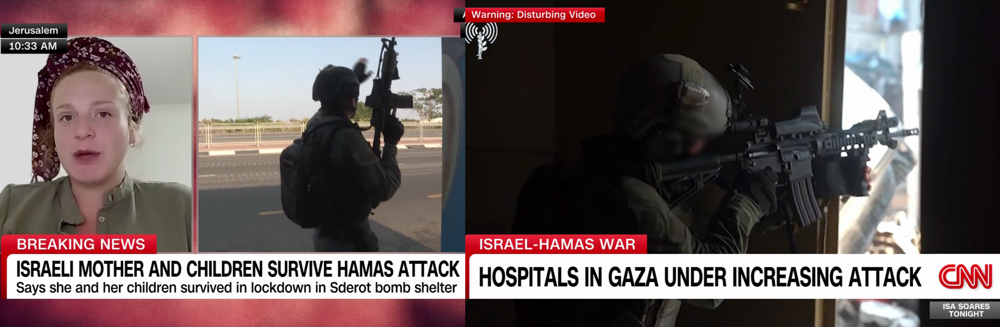

 - **Classify Western sentiment as Israeli / Arab / Neutral based on local sources**
 - **Analyze evolution over time, and examine classifications “rational” with LIME**

**Current Problem:** Western media in this dataset only covers 1 month (Oct26th-November 26th)